Mina

# Initializing

In [ ]:
import os
from google.colab import drive
drive.mount('/content/drive')
os.chdir('/content/drive/MyDrive/Work/Mina')

# os.chdir('/content/drive/MyDrive/Mina')
print("Current working directory: {0}".format(os.getcwd()))

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Current working directory: /content/drive/MyDrive/Work/Mina


# Loading Datasets

In [ ]:
# Installing requiered packages
!pip install neurokit2
!pip install tensorflow-addons
!pip install pyhrv
!pip install mne

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 18.1 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 19.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 230.8/230.8 KB 24.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 107.0/107.0 KB 13.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.7/55.7 KB 6.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for spectrum: filename=spectrum-0.8.1-cp38-cp38-linux_x86_64.whl size=237780 sha256=eb8d07102cf99d6b410c745c4d3bf24ff0339c9cfa6f5133ec23ca8ea7f078a4
  Stored in directory: /root/.cache/pip/wheels/8f/2c/22/4a514eb971c5f4693506f55ff7ff43fd501495322cb0b92464
  Created wheel for easydev: filename=easydev-0.

## MIT-BIH Dataset

In [ ]:
import numpy as np
import neurokit2 as nk
import warnings

In [ ]:
# Loading Variables from a File
import pickle

# Getting back the objects:
with open('MITBIH_ECG.pkl', 'rb') as f:  # Python 3: open(..., 'rb')
    MITBIH_ECG_X, MITBIH_ECG_Y = pickle.load(f)


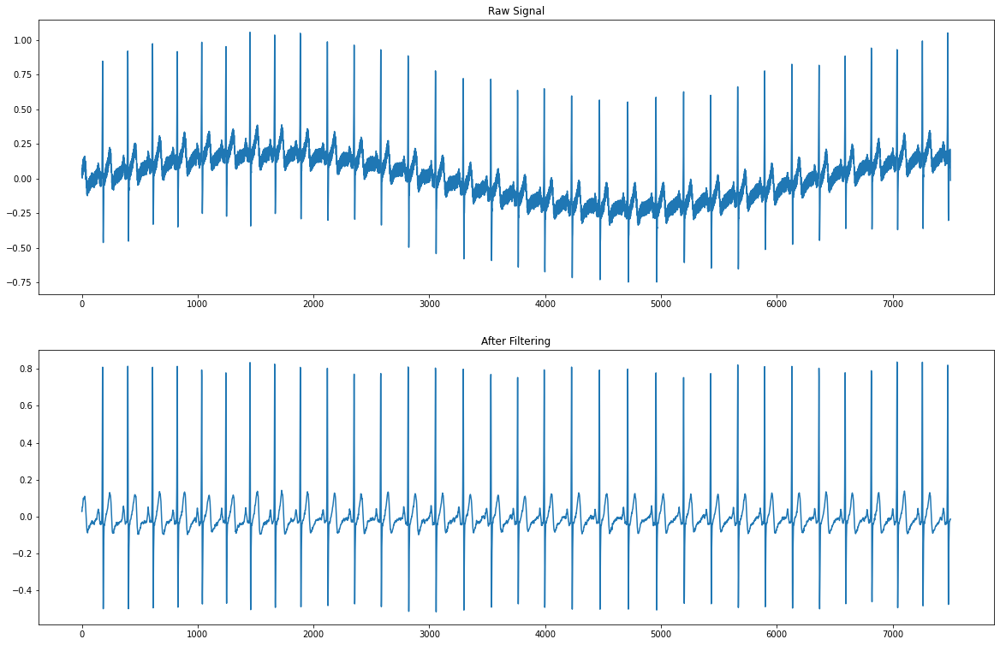

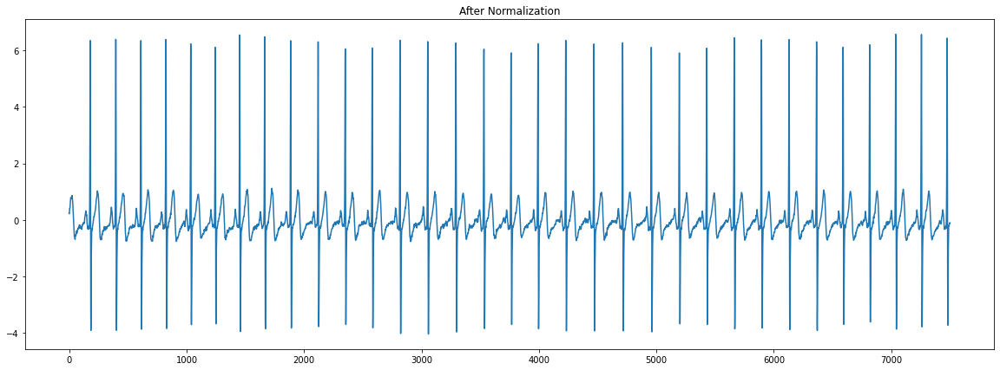

In [ ]:
# Visualization
from matplotlib import pyplot as plt

i=21
ecg_signal = MITBIH_ECG_X[i]
# plt.plot(ecg_signal)

signal1 = nk.signal_simulate(duration=30,frequency=0.04, amplitude=0.2,) # Low freq
signal1 = nk.signal_resample(signal1, sampling_rate=1000, desired_sampling_rate=250)
signal1 = np.expand_dims(signal1, axis=1)

# print(signal1.shape)

signal2 = nk.signal_simulate(duration=30,frequency=50, amplitude=0.05) # Low freq
signal2 = nk.signal_resample(signal2, sampling_rate=1000, desired_sampling_rate=250)
signal2 = np.expand_dims(signal2, axis=1)


# plt.plot(signal2)
# print(signal2.shape)


# print(ecg_signal.shape)

ecg_signal2 = ecg_signal + signal1 + signal2

fig, axs = plt.subplots(nrows=2, ncols=1, figsize=(20, 13))
axs = plt.subplot(2, 1, 1)
axs.set_title("Raw Signal")
plt.plot(ecg_signal2)
axs = plt.subplot(2, 1, 2)
axs.set_title("After Filtering")
plt.plot(ecg_signal)

from sklearn import preprocessing

scaler = preprocessing.StandardScaler().fit(ecg_signal)
ecg_signal3 = scaler.transform(ecg_signal)
fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(20, 7))
axs = plt.subplot(1, 1, 1)
axs.set_title("After Normalization")
plt.plot(ecg_signal3)

[218 213 214 211 209 208 213 221 233 231 230 237 236 239 239 231 229 237
 240 244 244 239 233 234 233 235 234 226 226 222 218 219]


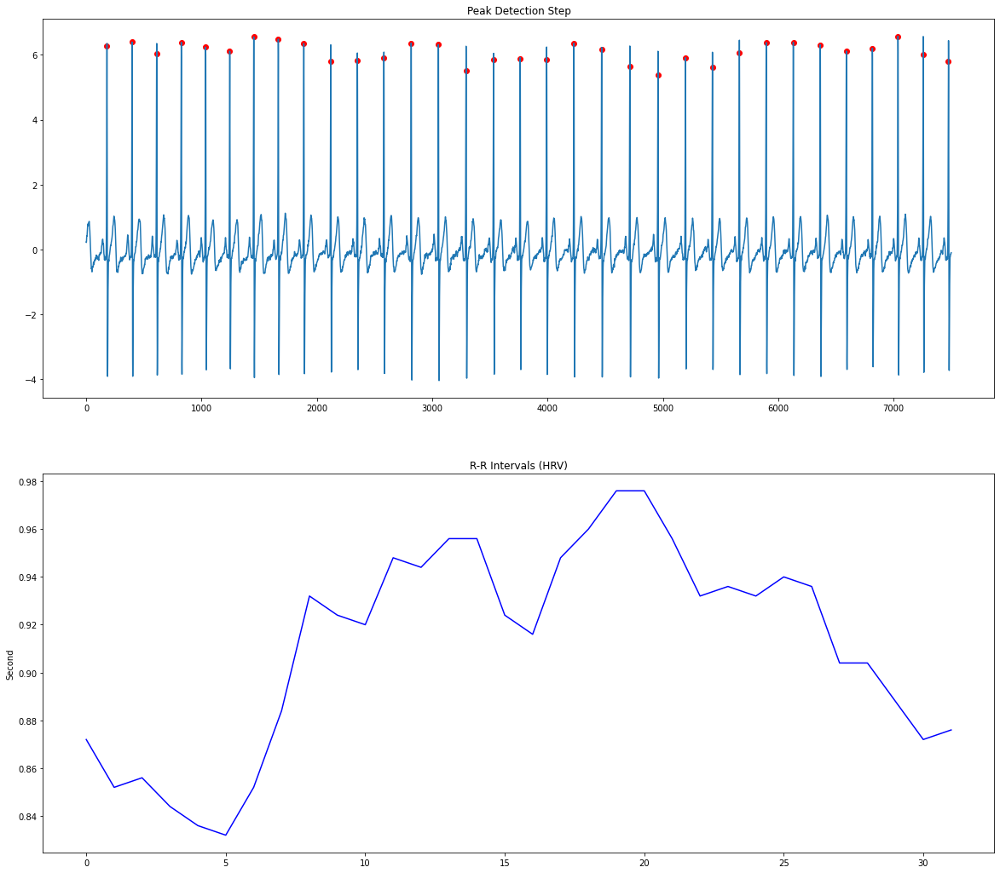

In [ ]:
# checking the peak detection and HRV calculation function for an example segment

import neurokit2 as nk
import numpy as np
from scipy.signal import find_peaks

sig = ecg_signal3[:,0]
rate = 250

# R-R peaks detection
rr1, _ = find_peaks(sig, distance=40, height=2)
rr2, _ = find_peaks(-sig, distance=40, height=2)

if len(rr1) < len(rr2):
    sig = -sig
#end if

# Calculating HRV Data for each segment
# Clean signal and Find peaks
ecg_cleaned = nk.ecg_clean(sig, sampling_rate=rate)
peaks, info = nk.ecg_peaks(ecg_cleaned, sampling_rate=rate, correct_artifacts=True)
print(np.diff(info['ECG_R_Peaks']))
# Compute HRV indices
hrv_indices = nk.hrv(peaks, sampling_rate=rate, show=False)

fig, axs = plt.subplots(nrows=2, ncols=1, figsize=(20, 18))
axs = plt.subplot(2, 1, 1)
axs.set_title("Peak Detection Step")

plt.plot(ecg_signal3)
plt.scatter(info['ECG_R_Peaks'],sig[info['ECG_R_Peaks']],c='red')

axs = plt.subplot(2, 1, 2)
axs.set_title("R-R Intervals (HRV)")
axs.set_ylabel('Second')
plt.plot(np.diff(info['ECG_R_Peaks'])/250,c='blue')

# axs = plt.subplot(3, 1, 3)
# axs.set_title("HRV Signal")
# # axs.set_ylabel('Second')

# plt.plot(np.diff(np.diff(info['ECG_R_Peaks'])/250),c='green')

# from scipy.signal import detrend, find_peaks
# sf = 250
# rr = info['ECG_R_Peaks']

# # R-R interval in ms
# rr = (rr / sf) * 1000
# rri = np.diff(rr)

# sf_up = 4
# rri_interp = interp_cubic_spline(rri, sf_up)
# hr = 1000 * (60 / rri_interp)
# # print('Mean HR: %.2f bpm' % np.mean(hr))

# # Detrend and normalize
# edr = detrend(hr)
# edr = (edr - edr.mean()) / edr.std()

# # Find respiratory peaks
# resp_peaks, _ = find_peaks(edr, height=0, distance=sf_up)

# # Convert to seconds
# resp_peaks = resp_peaks
# resp_peaks_diff = np.diff(resp_peaks) / sf_up

# edr = nk.signal_resample(edr,desired_length=121)
# # Plot the EDR waveform
# fig, axs = plt.subplots(nrows=1, ncols=1, figsize=(20, 7))
# plt.plot(edr, '-',c='purple')
# # plt.plot(resp_peaks, edr[resp_peaks], 'o')
# _ = plt.title('ECG derived respiration')




In [ ]:
info['ECG_R_Peaks']

array([ 179,  397,  610,  824, 1035, 1244, 1452, 1665, 1886, 2119, 2350,
       2580, 2817, 3053, 3292, 3531, 3762, 3991, 4228, 4468, 4712, 4956,
       5195, 5428, 5662, 5895, 6130, 6364, 6590, 6816, 7038, 7256, 7475])

In [ ]:
np.diff(np.diff(info['ECG_R_Peaks']))

array([-5,  1, -3, -2, -1,  5,  8, 12, -2, -1,  7, -1,  3,  0, -8, -2,  8,
        3,  4,  0, -5, -6,  1, -1,  2, -1, -8,  0, -4, -4,  1])

In [ ]:
# checking different classes count
print('normal')
print(MITBIH_ECG_Y.count(0))

print('obstructive')
print(MITBIH_ECG_Y.count(1))

print('central')
print(MITBIH_ECG_Y.count(2))

normal
6054
obstructive
3996
central
483


## NCHSDB Dataset

In [ ]:
# Loading Variables from a File
import pickle

# Getting back the objects:
with open('NCHSDB_ECG.pkl', 'rb') as f:  # Python 3: open(..., 'rb')
    NCHSDB_ECG_X, NCHSDB_ECG_Y = pickle.load(f)


In [ ]:
print('normal')
print(NCHSDB_ECG_Y.count(0))

print('obstructive')
print(NCHSDB_ECG_Y.count(1))

print('central')
print(NCHSDB_ECG_Y.count(2))

print('mix')
print(NCHSDB_ECG_Y.count(3))

normal
25051
obstructive
12785
central
6104
mix
2253


## CFS Dataset

In [ ]:
# Loading Variables from a File
import pickle

# Getting back the objects:
with open('CFS/CFS_ECG.pkl', 'rb') as f:  # Python 3: open(..., 'rb')
    CFS_ECG_X, CFS_ECG_Y = pickle.load(f)


In [ ]:
print('normal')
print(CFS_ECG_Y.count(0))

print('obstructive')
print(CFS_ECG_Y.count(1))

print('central')
print(CFS_ECG_Y.count(2))

print('mix')
print(CFS_ECG_Y.count(3))

normal
0
obstructive
32410
central
4760
mix
48


# Preprocessing

In [ ]:
# from sklearn import preprocessing
# import neurokit2 as nk

# MITBIH_ECG_X_PROCESSED=[]
# NCHSDB_ECG_X_PROCESSED=[]
# CFS_ECG_X_PROCESSED=[]


# print("[INFO] MITBIH Preprocessing ...")
# for i in range(len(MITBIH_ECG_X)):

#     # Normalizing Data

#     # Replacing Inf Values and Nan Values with 0
#     MITBIH_ECG_X[i][np.isinf(MITBIH_ECG_X[i])] = 0
#     MITBIH_ECG_X[i][np.isnan(MITBIH_ECG_X[i])] = 0

#     scaler = preprocessing.StandardScaler().fit(MITBIH_ECG_X[i])
#     MITBIH_ECG_X_PROCESSED.append(scaler.transform(MITBIH_ECG_X[i]))



# print("[INFO] NCHSDB Preprocessing ...")
# for i in range(len(NCHSDB_ECG_X)):
#     # Normalizing Data
#     # Replacing Inf Values and Nan Values with 0
#     NCHSDB_ECG_X[i][np.isinf(NCHSDB_ECG_X[i])] = 0
#     NCHSDB_ECG_X[i][np.isnan(NCHSDB_ECG_X[i])] = 0
#     try:
#         ecg_signal = nk.signal_resample(NCHSDB_ECG_X[i], sampling_rate=256, desired_sampling_rate=250)
#         if len(ecg_signal) == 30*250:
#             scaler = preprocessing.StandardScaler().fit(np.expand_dims(NCHSDB_ECG_X[i], 1))
#             NCHSDB_ECG_X_PROCESSED.append(scaler.transform(np.expand_dims(ecg_signal, 1)))
#     except:
#         print("Something else went wrong")



# print("[INFO] CFS Preprocessing ...")
# for i in range(len(CFS_ECG_X)):
#     # Normalizing Data
#     # Replacing Inf Values and Nan Values with 0
#     CFS_ECG_X[i][np.isinf(CFS_ECG_X[i])] = 0
#     CFS_ECG_X[i][np.isnan(CFS_ECG_X[i])] = 0
#     try:
#         scaler = preprocessing.StandardScaler().fit(np.expand_dims(CFS_ECG_X[i], 1))
#         CFS_ECG_X_PROCESSED.append(scaler.transform(np.expand_dims(CFS_ECG_X[i], 1)))
#     except:
#         print("Something else went wrong")

In [ ]:
# # Saveing Variables in a File
# import pickle

# # Saving the objects:
# with open('ECG_PROCESSED_MITBIH.pkl', 'wb',) as f:  # Python 3: open(..., 'wb')
#     pickle.dump([MITBIH_ECG_X_PROCESSED, MITBIH_ECG_Y], f,) #, HRV_X_PROCESSED, EDR_X_PROCESSED

# # Saving the objects:
# with open('ECG_PROCESSED_NCHSDB.pkl', 'wb',) as f:  # Python 3: open(..., 'wb')
#     pickle.dump([NCHSDB_ECG_X_PROCESSED, NCHSDB_ECG_Y], f,) #, HRV_X_PROCESSED, EDR_X_PROCESSED

# # Saving the objects:
# with open('ECG_PROCESSED_CFS.pkl', 'wb',) as f:  # Python 3: open(..., 'wb')
#     pickle.dump([CFS_ECG_X_PROCESSED, CFS_ECG_Y], f,) #, HRV_X_PROCESSED, EDR_X_PROCESSED

In [ ]:
# Loading Variables from a File
import pickle

# Getting back the objects:
with open('ECG_PROCESSED_MITBIH.pkl', 'rb') as f:  # Python 3: open(..., 'rb')
    MITBIH_ECG_X_PROCESSED, MITBIH_ECG_Y = pickle.load(f) #, HRV_X_PROCESSED, EDR_X_PROCESSED

# Getting back the objects:
with open('ECG_PROCESSED_NCHSDB.pkl', 'rb') as f:  # Python 3: open(..., 'rb')
    NCHSDB_ECG_X_PROCESSED, NCHSDB_ECG_Y = pickle.load(f) #, HRV_X_PROCESSED, EDR_X_PROCESSED

# Getting back the objects:
with open('ECG_PROCESSED_CFS.pkl', 'rb') as f:  # Python 3: open(..., 'rb')
    CFS_ECG_X_PROCESSED, CFS_ECG_Y = pickle.load(f) #, HRV_X_PROCESSED, EDR_X_PROCESSED

# Merge datasets together

In [ ]:
MITBIH_ECG_X_PROCESSED = np.array(MITBIH_ECG_X_PROCESSED)
MITBIH_ECG_Y = np.array(MITBIH_ECG_Y)
NCHSDB_ECG_X_PROCESSED = np.array(NCHSDB_ECG_X_PROCESSED)
NCHSDB_ECG_Y = np.array(NCHSDB_ECG_Y)
CFS_ECG_X_PROCESSED = np.array(CFS_ECG_X_PROCESSED)
CFS_ECG_Y = np.array(CFS_ECG_Y)

In [ ]:
MITBIH_ECG_X_PROCESSED.shape

(10530, 7500, 1)

In [ ]:
NCHSDB_ECG_X_PROCESSED.shape

(46188, 7500, 1)

In [ ]:
CFS_ECG_X_PROCESSED.shape

(37218, 7500, 1)

In [ ]:
# Merging
All_ECG_X = []
All_ECG_Y = []

for i in range(len(NCHSDB_ECG_X_PROCESSED)+len(MITBIH_ECG_X_PROCESSED)+len(CFS_ECG_X_PROCESSED)):

    if i<len(MITBIH_ECG_X_PROCESSED):
        All_ECG_X.append(MITBIH_ECG_X_PROCESSED[i,:,0])
        All_ECG_Y.append(MITBIH_ECG_Y[i])

    elif i>(len(MITBIH_ECG_X_PROCESSED)-1) and i < (len(NCHSDB_ECG_X_PROCESSED)+len(MITBIH_ECG_X_PROCESSED)):
        All_ECG_X.append(NCHSDB_ECG_X_PROCESSED[i-len(MITBIH_ECG_X_PROCESSED),:,0])
        All_ECG_Y.append(NCHSDB_ECG_Y[i-len(MITBIH_ECG_X_PROCESSED)])

    elif i>(len(NCHSDB_ECG_X_PROCESSED)+len(MITBIH_ECG_X_PROCESSED)):
        All_ECG_X.append(CFS_ECG_X_PROCESSED[i-(len(NCHSDB_ECG_X_PROCESSED)+len(MITBIH_ECG_X_PROCESSED)),:,0])
        All_ECG_Y.append(CFS_ECG_Y[i-(len(NCHSDB_ECG_X_PROCESSED)+len(MITBIH_ECG_X_PROCESSED))])

MITBIH_ECG_X_PROCESSED, MITBIH_ECG_Y,NCHSDB_ECG_X_PROCESSED, NCHSDB_ECG_Y, CFS_ECG_X_PROCESSED,CFS_ECG_Y = [],[],[],[],[],[] #free up RAM

In [ ]:
print('normal')
print(All_ECG_Y.count(0))

print('obstructive')
print(All_ECG_Y.count(1))

print('central')
print(All_ECG_Y.count(2))

print('mix')
print(All_ECG_Y.count(3))

print(np.array(All_ECG_X).shape)
print(np.array(All_ECG_Y).shape)

normal
31099
obstructive
49189
central
11346
mix
2301
(93935, 7500)
(93935,)


# Calculating HRV & EDR

In [ ]:
def HRV_calc(sig, rate):
    import neurokit2 as nk
    import numpy as np
    from scipy.signal import find_peaks

    # R-R peaks detection
    rr1, _ = find_peaks(sig, distance=40, height=2)
    rr2, _ = find_peaks(-sig, distance=40, height=2)

    if len(rr1) < len(rr2):
        sig = -sig
    #end if

    # Calculating HRV Data for each segment
    # Clean signal and Find peaks
    ecg_cleaned = nk.ecg_clean(sig, sampling_rate=rate)
    peaks, info = nk.ecg_peaks(ecg_cleaned, sampling_rate=rate, correct_artifacts=True)
    # Compute HRV indices
    hrv_indices = nk.hrv(peaks, sampling_rate=rate, show=False)
    # print(hrv_indices.keys())

    return np.transpose(hrv_indices)
#end HRV_calc

In [ ]:
# Interpolate and compute HR
def interp_cubic_spline(rri, sf_up=4):
    """

   .
    Taken from the `hrv` python package by Rhenan Bartels.

    Parameters
    ----------
    rri : np.array
        R-R peak interval (in ms)
    sf_up : float
        Upsampling frequency.

    Returns
    -------
    rri_interp : np.array
        Upsampled/interpolated R-R peak interval array
    """
    from scipy.interpolate import splrep, splev

    rri_time = np.cumsum(rri) / 1000.0
    time_rri = rri_time - rri_time[0]
    time_rri_interp = np.arange(0, time_rri[-1], 1 / float(sf_up))
    tck = splrep(time_rri, rri, s=0)
    rri_interp = splev(time_rri_interp, tck, der=0)

    return rri_interp

In [ ]:
def EDR_calc(ecg, freq, plot=False):
    from scipy.signal import detrend, find_peaks
    sf = freq

    # R-R peaks detection
    rr1, _ = find_peaks(ecg, distance=40, height=2)
    rr2, _ = find_peaks(-ecg, distance=40, height=2)

    if len(rr1) > len(rr2):
        rr = rr1
    else:
        rr = rr2
    #end if

    # R-R interval in ms
    rr = (rr / sf) * 1000
    rri = np.diff(rr)

    sf_up = 4
    rri_interp = interp_cubic_spline(rri, sf_up)
    hr = 1000 * (60 / rri_interp)
    # print('Mean HR: %.2f bpm' % np.mean(hr))

    # Detrend and normalize
    edr = detrend(hr)
    edr = (edr - edr.mean()) / edr.std()

    # Find respiratory peaks
    resp_peaks, _ = find_peaks(edr, height=0, distance=sf_up)

    # Convert to seconds
    resp_peaks = resp_peaks
    resp_peaks_diff = np.diff(resp_peaks) / sf_up

    if plot:
        # Plot the EDR waveform
        plt.plot(edr, '-')
        plt.plot(resp_peaks, edr[resp_peaks], 'o')
        _ = plt.title('ECG derived respiration')
    #end if

    return edr, resp_peaks

In [ ]:
i=10000
test_hrv = HRV_calc(All_ECG_X[i],250)

/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(


In [ ]:
import pandas
pandas.set_option('display.max_rows', None)
display(test_hrv)
len(test_hrv)

,0
HRV_MeanNN,874.424242
HRV_SDNN,142.302282
HRV_SDANN1,NaN
HRV_SDNNI1,NaN
HRV_SDANN2,NaN
HRV_SDNNI2,NaN
HRV_SDANN5,NaN
HRV_SDNNI5,NaN
HRV_RMSSD,70.178344
HRV_SDSD,69.762732


80

In [ ]:
All_X = []
All_Y = []
All_EDR_X = []

for i in range(len(All_ECG_X)):
    try:
        t_hrv = HRV_calc(All_ECG_X[i],250)
        t_hrv = np.array(t_hrv)
        t_edr, edr_peaks = EDR_calc(All_ECG_X[i],250)
        t_edr = np.array(t_edr)
        edr_peaks = np.array(edr_peaks)

        ''' HRV Features: 'HRV_MeanNN', 'HRV_SDNN', 'HRV_RMSSD', 'HRV_SDSD',
       'HRV_MedianNN', 'HRV_MadNN', 'HRV_IQRNN', 'HRV_Prc20NN', 'HRV_Prc80NN', 'HRV_pNN50', 'HRV_pNN20',
       'HRV_MinNN', 'HRV_MaxNN', 'HRV_HTI', 'HRV_TINN'
       '''
        # ans = np.concatenate((t_hrv[0:2], t_hrv[8:10], t_hrv[12:14], t_hrv[15:]), axis=0)
        ans = t_hrv
        ans = np.append(ans, len(edr_peaks))
        All_X.append(ans)
        All_Y.append(All_ECG_Y[i])
        All_EDR_X.append(t_edr)
    except:
        print(i," Something else went wrong")

#end for

print(np.array(All_X).shape)

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum durat

8912  Something else went wrong
8913  Something else went wrong
8914  Something else went wrong


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/

10578  Something else went wrong
10579  Something else went wrong
10580  Something else went wrong
10581  Something else went wrong
10582  Something else went wrong
10583  Something else went wrong
10584  Something else went wrong
10585  Something else went wrong
10586  Something else went wrong
10587  Something else went wrong
10588  Something else went wrong
10589  Something else went wrong
10590  Something else went wrong
10591  Something else went wrong
10593  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

10602  Something else went wrong
10603  Something else went wrong
10604  Something else went wrong
10605  Something else went wrong
10606  Something else went wrong
10607  Something else went wrong
10608  Something else went wrong
10610  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k


10611  Something else went wrong
10612  Something else went wrong
10613  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

10716  Something else went wrong
10717  Something else went wrong
10718  Something else went wrong
10719  Something else went wrong
10720  Something else went wrong
10721  Something else went wrong
10722  Something else went wrong
10723  Something else went wrong
10724  Something else went wrong
10725  Something else went wrong
10726  Something else went wrong
10727  Something else went wrong
10728  Something else went wrong
10729  Something else went wrong
10730  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related 

10913  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

10916  Something else went wrong
10917  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

10921  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

10926  Something else went wrong
10927  Something else went wrong
10928  Something else went wrong


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum durat

13676  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

14652  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

14656  Something else went wrong
14657  Something else went wrong
14658  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

15875  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid 

17290  Something else went wrong
17292  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

17295  Something else went wrong
17296  Something else went wrong
17297  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

17301  Something else went wrong
17302  Something else went wrong
17305  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

17308  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

19140  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

19146  Something else went wrong
19147  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

20413  Something else went wrong
20414  Something else went wrong
20415  Something else went wrong
20416  Something else went wrong
20417  Something else went wrong
20418  Something else went wrong
20419  Something else went wrong
20420  Something else went wrong
20421  Something else went wrong
20422  Something else went wrong


/usr/local/lib/python3.8/dist-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: inva

20833  Something else went wrong


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum durat

24387  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

24465  Something else went wrong
24466  Something else went wrong
24467  Something else went wrong
24468  Something else went wrong
24469  Something else went wrong
24470  Something else went wrong
24471  Something else went wrong
24472  Something else went wrong
24473  Something else went wrong
24474  Something else went wrong


/usr/local/lib/python3.8/dist-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.8/dist-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/usr/local/lib/python3.8/dist-packages/numpy/lib/nanfunctions.py:1117: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_time.py:150: RuntimeWarning: Mean of empty slice
  out["MeanNN"] = np.nanmean(rri)
/usr/local/lib/python3.8/dist-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided f

24671  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

26250  Something else went wrong
26251  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

26604  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

28378  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related 

28581  Something else went wrong
28582  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

30138  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

30894  Something else went wrong
30895  Something else went wrong
30896  Something else went wrong
30897  Something else went wrong
30898  Something else went wrong
30899  Something else went wrong
30900  Something else went wrong
30901  Something else went wrong
30902  Something else went wrong
30903  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/signal/signal_fixpeaks.py:277: RuntimeWarning: invalid value encountered in true_divide
  mrrs /= th2
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_time.py:157: RuntimeWarning: Mean of empty slice
  out["RMSSD"] = np.sqrt(np.nanmean(diff_rri**2))
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  w

30994  Something else went wrong
30995  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

31007  Something else went wrong
31009  Something else went wrong
31010  Something else went wrong
31011  Something else went wrong
31012  Something else went wrong
31014  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

31020  Something else went wrong
31021  Something else went wrong
31022  Something else went wrong
31023  Something else went wrong
31024  Something else went wrong
31025  Something else went wrong
31026  Something else went wrong
31027  Something else went wrong
31028  Something else went wrong
31030  Something else went wrong
31031  Something else went wrong
31032  Something else went wrong


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum durat

32963  Something else went wrong
32964  Something else went wrong
32965  Something else went wrong
32966  Something else went wrong
32967  Something else went wrong
32968  Something else went wrong
32969  Something else went wrong
32970  Something else went wrong
32971  Something else went wrong
32972  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

33963  Something else went wrong
33964  Something else went wrong
33965  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

35502  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

36750  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

36852  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

38024  Something else went wrong
38025  Something else went wrong
38026  Something else went wrong
38027  Something else went wrong
38028  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

38772  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid 

39661  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

40558  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

40790  Something else went wrong
40791  Something else went wrong
40792  Something else went wrong
40793  Something else went wrong
40794  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related 

41166  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` arg

41323  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

41672  Something else went wrong
41673  Something else went wrong
41674  Something else went wrong
41675  Something else went wrong
41676  Something else went wrong
41677  Something else went wrong
41678  Something else went wrong
41679  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_com

41687  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

42422  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related 

42941  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

43212  Something else went wrong
43213  Something else went wrong
43214  Something else went wrong
43215  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

44906  Something else went wrong


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum durat

47049  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

47429  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

48273  Something else went wrong
48274  Something else went wrong


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum durat

50290  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

50522  Something else went wrong
50523  Something else went wrong
50524  Something else went wrong
50525  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

51024  Something else went wrong
51025  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

51677  Something else went wrong
51678  Something else went wrong
51679  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related 

52832  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

54528  Something else went wrong


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/

56728  Something else went wrong
56730  Something else went wrong
56731  Something else went wrong
56733  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

57707  Something else went wrong
57709  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

57711  Something else went wrong
57714  Something else went wrong
57715  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

57865  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

58046  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

58058  Something else went wrong
58060  Something else went wrong
58062  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-

58066  Something else went wrong
58067  Something else went wrong
58068  Something else went wrong
58070  Something else went wrong
58071  Something else went wrong
58074  Something else went wrong
58075  Something else went wrong
58076  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

58088  Something else went wrong
58090  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

58122  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid 

58130  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

59252  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

60608  Something else went wrong
60609  Something else went wrong
60610  Something else went wrong
60612  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

60668  Something else went wrong
60670  Something else went wrong
60671  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

60677  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related 

60795  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

61739  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

61918  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

63270  Something else went wrong
63273  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

63305  Something else went wrong
63308  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

63310  Something else went wrong
63312  Something else went wrong
63313  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

63317  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

63331  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

63336  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

63342  Something else went wrong
63343  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

63349  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related 

63853  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

63885  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

63937  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

63947  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

64486  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

64675  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

65332  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

65376  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

66918  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

66923  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

66936  Something else went wrong
66939  Something else went wrong
66940  Something else went wrong
66942  Something else went wrong
66943  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

66944  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

66950  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k


66953  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

66961  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

68202  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

68247  Something else went wrong


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum durat

71073  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

71568  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

71575  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

71936  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

71946  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

72341  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

72815  Something else went wrong
72816  Something else went wrong
72819  Something else went wrong
72821  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

72825  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

72975  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

73245  Something else went wrong
73246  Something else went wrong
73247  Something else went wrong
73248  Something else went wrong
73249  Something else went wrong
73250  Something else went wrong
73251  Something else went wrong
73252  Something else went wrong
73253  Something else went wrong
73254  Something else went wrong
73255  Something else went wrong
73256  Something else went wrong
73257  Something else went wrong
73258  Something else went wrong
73259  Something else went wrong
73260  Something else went wrong
73261  Something else went wrong
73262  Something else went wrong
73263  Something else went wrong
73264  Something else went wrong
73265  Something else went wrong
73266  Something else went wrong
73267  Something else went wrong
73268  Something else went wrong
73269  Something else went wrong
73270  Something else went wrong
73271  Something else went wrong
73272  Something else went wrong
73273  Something else went wrong
73274  Something else went wrong
73275  Som

/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related 

73920  Something else went wrong
73921  Something else went wrong
73922  Something else went wrong
73923  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

74282  Something else went wrong
74284  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

74292  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

75591  Something else went wrong
75592  Something else went wrong
75593  Something else went wrong
75594  Something else went wrong
75595  Something else went wrong
75596  Something else went wrong
75597  Something else went wrong
75598  Something else went wrong
75599  Something else went wrong
75600  Something else went wrong
75601  Something else went wrong
75602  Something else went wrong
75603  Something else went wrong
75604  Something else went wrong
75605  Something else went wrong
75606  Something else went wrong
75607  Something else went wrong
75608  Something else went wrong
75609  Something else went wrong
75610  Something else went wrong
75611  Something else went wrong
75612  Something else went wrong
75613  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_time.py:161: RuntimeWarning: invalid value encountered in double_scalars
  out["CVNN"] = out["SDNN"] / out["MeanNN"]
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_time.py:162: RuntimeWarning: invalid value encountered in double_scalars
  out["CVSD"] = out["RMSSD"] / out["MeanNN"]
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_time.py:167: RuntimeWarning: invalid value encountered in double_scalars
  out["MCVNN"] = out["MadNN"] / out["MedianNN"]  # Normalized


75614  Something else went wrong
75615  Something else went wrong
75616  Something else went wrong
75617  Something else went wrong
75618  Something else went wrong
75619  Something else went wrong
75620  Something else went wrong
75621  Something else went wrong
75622  Something else went wrong
75623  Something else went wrong
75624  Something else went wrong
75625  Something else went wrong
75626  Something else went wrong
75627  Something else went wrong
75628  Something else went wrong
75629  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related 

75909  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

77027  Something else went wrong
77028  Something else went wrong
77029  Something else went wrong
77030  Something else went wrong
77031  Something else went wrong
77032  Something else went wrong
77033  Something else went wrong
77034  Something else went wrong
77035  Something else went wrong
77036  Something else went wrong
77037  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

77084  Something else went wrong
77085  Something else went wrong
77086  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

77087  Something else went wrong
77088  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-

77090  Something else went wrong
77091  Something else went wrong
77092  Something else went wrong
77093  Something else went wrong
77094  Something else went wrong
77095  Something else went wrong
77096  Something else went wrong
77097  Something else went wrong
77098  Something else went wrong
77099  Something else went wrong
77100  Something else went wrong


/usr/local/lib/python3.8/dist-packages/numpy/lib/nanfunctions.py:1670: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/usr/local/lib/python3.8/dist-packages/neurokit2/signal/signal_fixpeaks.py:277: RuntimeWarning: invalid value encountered in true_divide
  mrrs /= th2
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_time.py:157: RuntimeWarning: Mean of empty slice
  out["RMSSD"] = np.sqrt(np.nanmean(diff_rri**2))
/usr/local/lib/python3.8/dist-packages/numpy/core/fromnumeric.py:3440: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.8/dist-packages/numpy/core/_methods.py:189: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_time.py:161: RuntimeWarning: invalid value encountered in double_scalars
  out["CVNN"] = out["SDNN"] / out["MeanNN"]
/usr/local/l

77103  Something else went wrong
77104  Something else went wrong
77105  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

77535  Something else went wrong


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_non

80002  Something else went wrong
80003  Something else went wrong
80004  Something else went wrong
80005  Something else went wrong
80006  Something else went wrong
80007  Something else went wrong
80008  Something else went wrong
80009  Something else went wrong
80010  Something else went wrong
80011  Something else went wrong
80012  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

80510  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

81770  Something else went wrong
81772  Something else went wrong
81774  Something else went wrong
81775  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

81777  Something else went wrong
81781  Something else went wrong
81782  Something else went wrong
81783  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

83068  Something else went wrong
83073  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83076  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

83386  Something else went wrong
83389  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83399  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-

83408  Something else went wrong
83409  Something else went wrong
83410  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83422  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83427  Something else went wrong
83428  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83433  Something else went wrong
83434  Something else went wrong
83435  Something else went wrong
83436  Something else went wrong
83437  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k


83440  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83443  Something else went wrong
83445  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83449  Something else went wrong
83451  Something else went wrong
83452  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

83454  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83461  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83464  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83468  Something else went wrong
83473  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83485  Something else went wrong
83488  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83498  Something else went wrong
83500  Something else went wrong
83503  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83505  Something else went wrong
83508  Something else went wrong
83510  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83525  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83530  Something else went wrong
83533  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83542  Something else went wrong
83543  Something else went wrong
83545  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

83551  Something else went wrong
83552  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83570  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83577  Something else went wrong
83580  Something else went wrong
83581  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83586  Something else went wrong
83587  Something else went wrong
83588  Something else went wrong
83589  Something else went wrong
83590  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83594  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83601  Something else went wrong
83605  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83608  Something else went wrong
83612  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83615  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83619  Something else went wrong
83622  Something else went wrong
83623  Something else went wrong
83625  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83629  Something else went wrong
83631  Something else went wrong
83633  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83639  Something else went wrong
83640  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83645  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83647  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83655  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83662  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83670  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83674  Something else went wrong
83676  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83681  Something else went wrong
83683  Something else went wrong
83684  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83696  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83701  Something else went wrong
83703  Something else went wrong
83704  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83709  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83715  Something else went wrong
83716  Something else went wrong
83717  Something else went wrong
83718  Something else went wrong
83723  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83728  Something else went wrong
83729  Something else went wrong
83730  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83743  Something else went wrong
83747  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83753  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83758  Something else went wrong
83760  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83774  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-

83778  Something else went wrong
83780  Something else went wrong
83782  Something else went wrong
83783  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83789  Something else went wrong
83790  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83800  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83808  Something else went wrong
83809  Something else went wrong
83812  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83814  Something else went wrong
83815  Something else went wrong
83817  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83825  Something else went wrong
83828  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83835  Something else went wrong
83838  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83840  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83846  Something else went wrong
83847  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83855  Something else went wrong
83857  Something else went wrong
83859  Something else went wrong
83860  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83863  Something else went wrong
83864  Something else went wrong
83866  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83881  Something else went wrong
83886  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-

83891  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

83898  Something else went wrong
83899  Something else went wrong
83901  Something else went wrong
83902  Something else went wrong
83903  Something else went wrong
83904  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83909  Something else went wrong
83912  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

83917  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83924  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

83931  Something else went wrong
83934  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-

83940  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

84059  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

84083  Something else went wrong
84084  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

84151  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

84789  Something else went wrong


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_mul

86805  Something else went wrong
86806  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

87104  Something else went wrong
87105  Something else went wrong
87106  Something else went wrong
87107  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

87112  Something else went wrong
87113  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

87114  Something else went wrong
87115  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

87116  Something else went wrong
87117  Something else went wrong
87118  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related 

87123  Something else went wrong
87124  Something else went wrong
87125  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices wil

87129  Something else went wrong
87132  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

87133  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices wil

87187  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

87198  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

87204  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

87211  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related 

87279  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

87984  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

88011  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encou

88147  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

89018  Something else went wrong
89019  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

89024  Something else went wrong
89026  Something else went wrong
89027  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

89028  Something else went wrong
89033  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

89392  Something else went wrong
89393  Something else went wrong
89394  Something else went wrong
89395  Something else went wrong
89396  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related 

90315  Something else went wrong
90316  Something else went wrong
90317  Something else went wrong
90318  Something else went wrong
90319  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

90321  Something else went wrong
90323  Something else went wrong
90324  Something else went wrong
90325  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

90326  Something else went wrong
90327  Something else went wrong
90328  Something else went wrong
90330  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

90333  Something else went wrong
90336  Something else went wrong
90337  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

90338  Something else went wrong
90342  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

90343  Something else went wrong
90345  Something else went wrong
90346  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

90351  Something else went wrong
90352  Something else went wrong
90353  Something else went wrong
90355  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

90356  Something else went wrong
90357  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

90368  Something else went wrong
90369  Something else went wrong
90370  Something else went wrong
90371  Something else went wrong
90372  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

90374  Something else went wrong
90375  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

91111  Something else went wrong


Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_non

92559  Something else went wrong
92561  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

92827  Something else went wrong
92829  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

92834  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

92838  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

92846  Something else went wrong
92847  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

92856  Something else went wrong
92858  Something else went wrong
92860  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

92870  Something else went wrong
92875  Something else went wrong
92876  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

92882  Something else went wrong
92883  Something else went wrong
92884  Something else went wrong
92888  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

92891  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-

92894  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

92898  Something else went wrong
92900  Something else went wrong
92902  Something else went wrong
92905  Something else went wrong
92906  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

92911  Something else went wrong
92916  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

92919  Something else went wrong
92921  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

92927  Something else went wrong
92928  Something else went wrong
92931  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

92933  Something else went wrong


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/entropy_multiscale.py:349: RuntimeWarning: invalid value encountered in double_scalars
  mse = np.trapz(mse) / len(mse)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:134: RuntimeWarning: divide by zero encountered in true_divide
  normalization = (n - 1) / (np.floor((n - k_subrange) / k).astype(int) * k)
/usr/local/lib/python3.8/dist-packages/neurokit2/complexity/optim_complexity_k.py:135: RuntimeWarning: invalid value encountered in multiply
  sets = (np.nansum(np.abs(np.diff(sig_values)), axis=1) * normalization) / k
/usr/local/lib/python3.8/dist-

(93270, 81)


/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `nk.fractal_dfa()` for more information.
  warn(
/usr/local/lib/python3.8/dist-packages/neurokit2/hrv/hrv_nonlinear.py:474: NeuroKitWarning: DFA_alpha2 related indices will not be calculated. The maximum duration of the windows provided for the long-term correlation is smaller than the minimum duration of windows. Refer to the `scale` argument in `n

In [ ]:
np.array(All_X).shape

(93270, 81)

In [ ]:
keys = list(test_hrv[0].keys())
keys.append('EDR Peaks')
print(keys)

['HRV_MeanNN', 'HRV_SDNN', 'HRV_SDANN1', 'HRV_SDNNI1', 'HRV_SDANN2', 'HRV_SDNNI2', 'HRV_SDANN5', 'HRV_SDNNI5', 'HRV_RMSSD', 'HRV_SDSD', 'HRV_CVNN', 'HRV_CVSD', 'HRV_MedianNN', 'HRV_MadNN', 'HRV_MCVNN', 'HRV_IQRNN', 'HRV_Prc20NN', 'HRV_Prc80NN', 'HRV_pNN50', 'HRV_pNN20', 'HRV_MinNN', 'HRV_MaxNN', 'HRV_HTI', 'HRV_TINN', 'HRV_ULF', 'HRV_VLF', 'HRV_LF', 'HRV_HF', 'HRV_VHF', 'HRV_LFHF', 'HRV_LFn', 'HRV_HFn', 'HRV_LnHF', 'HRV_SD1', 'HRV_SD2', 'HRV_SD1SD2', 'HRV_S', 'HRV_CSI', 'HRV_CVI', 'HRV_CSI_Modified', 'HRV_PIP', 'HRV_IALS', 'HRV_PSS', 'HRV_PAS', 'HRV_GI', 'HRV_SI', 'HRV_AI', 'HRV_PI', 'HRV_C1d', 'HRV_C1a', 'HRV_SD1d', 'HRV_SD1a', 'HRV_C2d', 'HRV_C2a', 'HRV_SD2d', 'HRV_SD2a', 'HRV_Cd', 'HRV_Ca', 'HRV_SDNNd', 'HRV_SDNNa', 'HRV_DFA_alpha1', 'HRV_MFDFA_alpha1_Width', 'HRV_MFDFA_alpha1_Peak', 'HRV_MFDFA_alpha1_Mean', 'HRV_MFDFA_alpha1_Max', 'HRV_MFDFA_alpha1_Delta', 'HRV_MFDFA_alpha1_Asymmetry', 'HRV_MFDFA_alpha1_Fluctuation', 'HRV_MFDFA_alpha1_Increment', 'HRV_ApEn', 'HRV_SampEn', 'HRV_Shan

In [ ]:
import pandas
pandas.set_option('display.max_rows', None)
# display(All_X)
df = pandas.DataFrame(data=np.array(All_X), columns=keys)
pandas.set_option('display.max_columns', None)
df.describe()

,HRV_MeanNN,HRV_SDNN,HRV_SDANN1,HRV_SDNNI1,HRV_SDANN2,HRV_SDNNI2,HRV_SDANN5,HRV_SDNNI5,HRV_RMSSD,HRV_SDSD,HRV_CVNN,HRV_CVSD,HRV_MedianNN,HRV_MadNN,HRV_MCVNN,HRV_IQRNN,HRV_Prc20NN,HRV_Prc80NN,HRV_pNN50,HRV_pNN20,HRV_MinNN,HRV_MaxNN,HRV_HTI,HRV_TINN,HRV_ULF,HRV_VLF,HRV_LF,HRV_HF,HRV_VHF,HRV_LFHF,HRV_LFn,HRV_HFn,HRV_LnHF,HRV_SD1,HRV_SD2,HRV_SD1SD2,HRV_S,HRV_CSI,HRV_CVI,HRV_CSI_Modified,HRV_PIP,HRV_IALS,HRV_PSS,HRV_PAS,HRV_GI,HRV_SI,HRV_AI,HRV_PI,HRV_C1d,HRV_C1a,HRV_SD1d,HRV_SD1a,HRV_C2d,HRV_C2a,HRV_SD2d,HRV_SD2a,HRV_Cd,HRV_Ca,HRV_SDNNd,HRV_SDNNa,HRV_DFA_alpha1,HRV_MFDFA_alpha1_Width,HRV_MFDFA_alpha1_Peak,HRV_MFDFA_alpha1_Mean,HRV_MFDFA_alpha1_Max,HRV_MFDFA_alpha1_Delta,HRV_MFDFA_alpha1_Asymmetry,HRV_MFDFA_alpha1_Fluctuation,HRV_MFDFA_alpha1_Increment,HRV_ApEn,HRV_SampEn,HRV_ShanEn,HRV_FuzzyEn,HRV_MSEn,HRV_CMSEn,HRV_RCMSEn,HRV_CD,HRV_HFD,HRV_KFD,HRV_LZC,EDR Peaks
count,93270.000000,93270.000000,0.0,0.0,0.0,0.0,0.0,0.0,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,0.0,0.0,0.0,93265.000000,9.325500e+04,0.0,0.0,93265.000000,93265.000000,93270.000000,93270.000000,93270.000000,9.327000e+04,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,9.327000e+04,9.327000e+04,93270.000000,9.327000e+04,93270.000000,93270.000000,77918.000000,77454.000000,77454.000000,9.327000e+04,92456.000000,93270.000000,93270.000000,93270.000000
mean,831.783780,91.474843,NaN,NaN,NaN,NaN,NaN,NaN,83.243150,84.689568,0.101966,0.089256,826.727243,79.676103,0.091665,119.408363,755.106448,903.593636,24.089137,45.887606,683.142232,1019.733548,7.859498,112.330633,NaN,NaN,NaN,0.045365,4.019248e-03,NaN,NaN,0.919253,-3.741155,59.884568,109.677812,0.483793,7.038844e+04,2.698436,4.599887,1107.080489,0.517760,0.539546,0.772203,0.150137,50.480739,50.467227,50.497005,51.797086,0.544747,0.455253,43.927288,39.995535,0.483768,0.516232,75.088587,78.347123,0.495702,0.504298,63.389489,64.146496,1.117334,1.352346,1.351550,1.479263,-0.010585,-0.368081,-0.420622,2.653567e-03,2.303035e-01,0.317242,NaN,4.339736,1.093562,0.205037,0.242347,0.266181,1.712344e+00,1.677684,2.210965,0.949927,8.036732
std,213.863349,132.017202,NaN,NaN,NaN,NaN,NaN,NaN,176.598469,182.458272,0.093116,0.123562,213.108657,107.967082,0.092130,167.448569,185.442544,277.367450,23.575093,25.398245,175.230358,438.865917,3.047026,150.613428,NaN,NaN,NaN,0.044300,8.056845e-03,NaN,NaN,0.095919,1.306632,129.017481,136.190628,0.277564,5.905113e+05,1.465623,0.770985,1153.327677,0.111934,0.118833,0.150414,0.159312,6.473324,6.636253,6.407220,7.764421,0.136375,0.136375,91.794578,91.646463,0.123002,0.123002,98.112112,95.783915,0.097690,0.097690,93.764796,92.417520,0.397835,0.806520,0.430181,0.463257,0.698449,0.808762,0.231111,6.346949e-03,3.670999e-01,0.142043,NaN,0.449639,0.328106,0.316977,0.335194,0.374032,3.519734e-01,0.230909,27.896571,0.258536,4.222368
min,333.545455,1.738504,NaN,NaN,NaN,NaN,NaN,NaN,2.507133,2.548991,0.002175,0.002499,316.000000,0.000000,0.000000,0.000000,272.000000,340.000000,0.000000,0.000000,152.000000,356.000000,1.039474,0.000000,NaN,NaN,NaN,0.000071,5.412181e-07,NaN,NaN,0.040260,-9.557851,1.802409,1.471225,0.060170,9.491660e+00,0.150697,1.684312,3.523590,0.080000,0.125000,0.000000,0.000000,3.875969,2.692070,0.630485,10.000000,0.000401,0.000480,1.217161,1.328997,0.002125,0.015853,1.041661,0.970711,0.011088,0.007874,1.236583,1.236583,-2.468564,0.002944,-0.500346,-1.038754,-2.669166,-3.600529,-1.000000,3.984121e-10,7.590679e-07,0.000011,-inf,0.867968,0.115316,0.000000,0.000000,0.000000,-9.439279e-16,0.919861,-8470.6819

In [ ]:
# # Saveing Variables in a File
# import pickle

# # Saving the objects:
# with open('HRV_ALL2.pkl', 'wb',) as f:  # Python 3: open(..., 'wb')
#     pickle.dump([All_X, All_Y, All_EDR_X], f,) #, HRV_X_PROCESSED, EDR_X_PROCESSED

In [ ]:
# Loading Variables from a File
import pickle

# Getting back the objects:
with open('HRV_ALL2.pkl', 'rb') as f:  # Python 3: open(..., 'rb')
    All_X, All_Y, All_EDR_X = pickle.load(f) #, HRV_X_PROCESSED, EDR_X_PROCESSED

In [ ]:
import numpy as np

print('normal')
print(All_Y.count(0))

print('obstructive')
print(All_Y.count(1))

print('central')
print(All_Y.count(2))

print('mix')
print(All_Y.count(3))

print(np.array(All_X).shape)
print(np.array(All_Y).shape)

normal
30990
obstructive
48709
central
11283
mix
2288
(93270, 81)
(93270,)


In [ ]:
import pandas as pd
keys = 'HRV_MeanNN', 'HRV_SDNN', 'HRV_SDANN1', 'HRV_SDNNI1', 'HRV_SDANN2', 'HRV_SDNNI2', 'HRV_SDANN5', 'HRV_SDNNI5', 'HRV_RMSSD', 'HRV_SDSD', 'HRV_CVNN', 'HRV_CVSD', 'HRV_MedianNN', 'HRV_MadNN', 'HRV_MCVNN', 'HRV_IQRNN', 'HRV_Prc20NN', 'HRV_Prc80NN', 'HRV_pNN50', 'HRV_pNN20', 'HRV_MinNN', 'HRV_MaxNN', 'HRV_HTI', 'HRV_TINN', 'HRV_ULF', 'HRV_VLF', 'HRV_LF', 'HRV_HF', 'HRV_VHF', 'HRV_LFHF', 'HRV_LFn', 'HRV_HFn', 'HRV_LnHF', 'HRV_SD1', 'HRV_SD2', 'HRV_SD1SD2', 'HRV_S', 'HRV_CSI', 'HRV_CVI', 'HRV_CSI_Modified', 'HRV_PIP', 'HRV_IALS', 'HRV_PSS', 'HRV_PAS', 'HRV_GI', 'HRV_SI', 'HRV_AI', 'HRV_PI', 'HRV_C1d', 'HRV_C1a', 'HRV_SD1d', 'HRV_SD1a', 'HRV_C2d', 'HRV_C2a', 'HRV_SD2d', 'HRV_SD2a', 'HRV_Cd', 'HRV_Ca', 'HRV_SDNNd', 'HRV_SDNNa', 'HRV_DFA_alpha1', 'HRV_MFDFA_alpha1_Width', 'HRV_MFDFA_alpha1_Peak', 'HRV_MFDFA_alpha1_Mean', 'HRV_MFDFA_alpha1_Max', 'HRV_MFDFA_alpha1_Delta', 'HRV_MFDFA_alpha1_Asymmetry', 'HRV_MFDFA_alpha1_Fluctuation', 'HRV_MFDFA_alpha1_Increment', 'HRV_ApEn', 'HRV_SampEn', 'HRV_ShanEn', 'HRV_FuzzyEn', 'HRV_MSEn', 'HRV_CMSEn', 'HRV_RCMSEn', 'HRV_CD', 'HRV_HFD', 'HRV_KFD', 'HRV_LZC', 'EDR_Peaks'
All_X_df = pd.DataFrame(All_X, columns=keys
                        # ['HRV_MeanNN', 'HRV_SDNN', 'HRV_RMSSD', 'HRV_SDSD','HRV_MedianNN', 'HRV_MadNN', 'HRV_IQRNN', 'HRV_Prc20NN', 'HRV_Prc80NN', 'HRV_pNN50', 'HRV_pNN20','HRV_MinNN', 'HRV_MaxNN', 'HRV_HTI', 'HRV_TINN','EDR_Length']
       )
All_X_df = All_X_df.drop(columns=['HRV_SDANN1', 'HRV_SDNNI1', 'HRV_SDANN2', 'HRV_SDNNI2', 'HRV_SDANN5', 'HRV_SDNNI5', 'HRV_ULF', 'HRV_VLF', 'HRV_LF', 'HRV_LFHF', 'HRV_LFn', 'HRV_SampEn'])

In [ ]:
import pandas
pandas.set_option('display.max_rows', None)
pandas.set_option('display.max_columns', None)
All_X_df.describe()

,HRV_MeanNN,HRV_SDNN,HRV_RMSSD,HRV_SDSD,HRV_CVNN,HRV_CVSD,HRV_MedianNN,HRV_MadNN,HRV_MCVNN,HRV_IQRNN,HRV_Prc20NN,HRV_Prc80NN,HRV_pNN50,HRV_pNN20,HRV_MinNN,HRV_MaxNN,HRV_HTI,HRV_TINN,HRV_HF,HRV_VHF,HRV_HFn,HRV_LnHF,HRV_SD1,HRV_SD2,HRV_SD1SD2,HRV_S,HRV_CSI,HRV_CVI,HRV_CSI_Modified,HRV_PIP,HRV_IALS,HRV_PSS,HRV_PAS,HRV_GI,HRV_SI,HRV_AI,HRV_PI,HRV_C1d,HRV_C1a,HRV_SD1d,HRV_SD1a,HRV_C2d,HRV_C2a,HRV_SD2d,HRV_SD2a,HRV_Cd,HRV_Ca,HRV_SDNNd,HRV_SDNNa,HRV_DFA_alpha1,HRV_MFDFA_alpha1_Width,HRV_MFDFA_alpha1_Peak,HRV_MFDFA_alpha1_Mean,HRV_MFDFA_alpha1_Max,HRV_MFDFA_alpha1_Delta,HRV_MFDFA_alpha1_Asymmetry,HRV_MFDFA_alpha1_Fluctuation,HRV_MFDFA_alpha1_Increment,HRV_ApEn,HRV_ShanEn,HRV_FuzzyEn,HRV_MSEn,HRV_CMSEn,HRV_RCMSEn,HRV_CD,HRV_HFD,HRV_KFD,HRV_LZC,EDR_Peaks
count,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93265.000000,9.325500e+04,93265.000000,93265.000000,93270.000000,93270.000000,93270.000000,9.327000e+04,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,93270.000000,9.327000e+04,9.327000e+04,93270.000000,93270.000000,93270.000000,77918.000000,77454.000000,77454.000000,9.327000e+04,92456.000000,93270.000000,93270.000000,93270.000000
mean,831.783780,91.474843,83.243150,84.689568,0.101966,0.089256,826.727243,79.676103,0.091665,119.408363,755.106448,903.593636,24.089137,45.887606,683.142232,1019.733548,7.859498,112.330633,0.045365,4.019248e-03,0.919253,-3.741155,59.884568,109.677812,0.483793,7.038844e+04,2.698436,4.599887,1107.080489,0.517760,0.539546,0.772203,0.150137,50.480739,50.467227,50.497005,51.797086,0.544747,0.455253,43.927288,39.995535,0.483768,0.516232,75.088587,78.347123,0.495702,0.504298,63.389489,64.146496,1.117334,1.352346,1.351550,1.479263,-0.010585,-0.368081,-0.420622,2.653567e-03,2.303035e-01,0.317242,4.339736,1.093562,0.205037,0.242347,0.266181,1.712344e+00,1.677684,2.210965,0.949927,8.036732
std,213.863349,132.017202,176.598469,182.458272,0.093116,0.123562,213.108657,107.967082,0.092130,167.448569,185.442544,277.367450,23.575093,25.398245,175.230358,438.865917,3.047026,150.613428,0.044300,8.056845e-03,0.095919,1.306632,129.017481,136.190628,0.277564,5.905113e+05,1.465623,0.770985,1153.327677,0.111934,0.118833,0.150414,0.159312,6.473324,6.636253,6.407220,7.764421,0.136375,0.136375,91.794578,91.646463,0.123002,0.123002,98.112112,95.783915,0.097690,0.097690,93.764796,92.417520,0.397835,0.806520,0.430181,0.463257,0.698449,0.808762,0.231111,6.346949e-03,3.670999e-01,0.142043,0.449639,0.328106,0.316977,0.335194,0.374032,3.519734e-01,0.230909,27.896571,0.258536,4.222368
min,333.545455,1.738504,2.507133,2.548991,0.002175,0.002499,316.000000,0.000000,0.000000,0.000000,272.000000,340.000000,0.000000,0.000000,152.000000,356.000000,1.039474,0.000000,0.000071,5.412181e-07,0.040260,-9.557851,1.802409,1.471225,0.060170,9.491660e+00,0.150697,1.684312,3.523590,0.080000,0.125000,0.000000,0.000000,3.875969,2.692070,0.630485,10.000000,0.000401,0.000480,1.217161,1.328997,0.002125,0.015853,1.041661,0.970711,0.011088,0.007874,1.236583,1.236583,-2.468564,0.002944,-0.500346,-1.038754,-2.669166,-3.600529,-1.000000,3.984121e-10,7.590679e-07,0.000011,0.867968,0.115316,0.000000,0.000000,0.000000,-9.439279e-16,0.919861,-8470.681965,0.220208,0.000000
25%,682.476190,34.434943,23.242962,23.434870,0.045300,0.030432,672.000000,29.652000,0.039801,42.000000,624.000000,727.200000,3.333333,26.666667,560.000000,808.000000,5.666667,31.250000,0.009445,3.784811e-04,0.898182,-4.662297,16.570955,43.340306,0.293574,2.364079e+03,1.645247,4.080632,376.507606,0

EDR

In [ ]:
#finding max length of edr
max_len = 0
for i in range(len(All_EDR_X)):
  if len(All_EDR_X[i]) > max_len:
    max_len = len(All_EDR_X[i])
print(max_len)

120


In [ ]:
import neurokit2 as nk
for i in range(len(All_EDR_X)):
  if len(All_EDR_X[i]) != max_len:
    All_EDR_X[i] = nk.signal_resample(All_EDR_X[i], desired_length=max_len, sampling_rate=None, desired_sampling_rate=None, method='FFT')



In [ ]:
np.array(All_EDR_X).shape

(93270, 120)

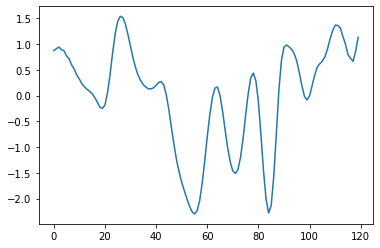

In [ ]:
from matplotlib import pyplot as plt
plt.plot(All_EDR_X[10200])

Balancing Data

In [ ]:
# print('mix')
# print(All_Y.count(3))

mix
2288


In [ ]:
# import random

# normal_HRV = []
# normal_EDR = []
# obs_HRV = []
# obs_EDR = []
# cen_HRV = []
# cen_EDR = []
# mix_HRV = []
# mix_EDR = []

# for i in range(len(All_Y)):
#   if All_Y[i]==0:
#     normal_HRV.append(All_X[i])
#     normal_EDR.append(All_EDR_X[i])
#   elif All_Y[i]==1:
#     obs_HRV.append(All_X[i])
#     obs_EDR.append(All_EDR_X[i])
#   elif All_Y[i]==2:
#     cen_HRV.append(All_X[i])
#     cen_EDR.append(All_EDR_X[i])
#   elif All_Y[i]==3:
#     mix_HRV.append(All_X[i])
#     mix_EDR.append(All_EDR_X[i])
# #end for

# random.seed(5)
# random.shuffle(normal_HRV)

# random.seed(5)
# random.shuffle(normal_EDR)

# random.seed(5)
# random.shuffle(obs_HRV)

# random.seed(5)
# random.shuffle(obs_EDR)

# random.seed(5)
# random.shuffle(cen_HRV)

# random.seed(5)
# random.shuffle(cen_EDR)

# balanced_x_hrv = []
# balanced_x_edr = []
# balanced_y = []

# for i in range(All_Y.count(3)*4):
#   balanced_x_hrv.append(normal_HRV[i])
#   balanced_x_edr.append(normal_EDR[i])
#   balanced_y.append(0)

#   balanced_x_hrv.append(obs_HRV[i])
#   balanced_x_edr.append(obs_EDR[i])
#   balanced_y.append(1)

#   balanced_x_hrv.append(cen_HRV[i])
#   balanced_x_edr.append(cen_EDR[i])
#   balanced_y.append(2)

# for i in range(All_Y.count(3)):
#   balanced_x_hrv.append(mix_HRV[i])
#   balanced_x_edr.append(mix_EDR[i])
#   balanced_y.append(3)

In [ ]:
# import numpy as np

# print('normal')
# print(balanced_y.count(0))

# print('obstructive')
# print(balanced_y.count(1))

# print('central')
# print(balanced_y.count(2))

# print('mix')
# print(balanced_y.count(3))

# print(np.array(balanced_x_hrv).shape)
# print(np.array(balanced_x_edr).shape)
# print(np.array(balanced_y).shape)

# PCA

## HRV

In [ ]:
for i in range(len(All_X)):
    All_X[i][np.isinf(All_X[i])] = 0
    All_X[i][np.isnan(All_X[i])] = 0

# #balanced
# for i in range(len(balanced_x_hrv)):
#     balanced_x_hrv[i][np.isinf(balanced_x_hrv[i])] = 0
#     balanced_x_hrv[i][np.isnan(balanced_x_hrv[i])] = 0

In [ ]:
from sklearn.decomposition import PCA
import pandas as pd

pca_std = PCA(n_components=5)
principalComponents_standard = pca_std.fit_transform(All_X)
print(pca_std.explained_variance_ratio_)

# #balanced
# pca_std_balanced = PCA(n_components=5)
# principalComponents_standard_balanced = pca_std_balanced.fit_transform(balanced_x_hrv)
# print(pca_std_balanced.explained_variance_ratio_)

[9.99995699e-01 3.36401540e-06 6.40592854e-07 1.69463485e-07
 5.65196838e-08]
[9.99995221e-01 3.75438125e-06 7.09872458e-07 1.88917025e-07
 5.70487001e-08]


# split a dataset into train and test sets


In [ ]:
randstate=10

## HRV

In [ ]:
# split a HRV dataset into train and test sets
import numpy as np
from sklearn.model_selection import train_test_split
HRV_X_train_val, HRV_X_test, HRV_Y_train_val, HRV_Y_test = train_test_split(principalComponents_standard, All_Y, test_size=0.1, random_state=randstate)
# HRV_X_train_val, HRV_X_test, HRV_Y_train_val, HRV_Y_test = train_test_split(principalComponents_standard_balanced, balanced_y, test_size=0.1, random_state=randstate) #balanced
HRV_X_train, HRV_X_val, HRV_Y_train, HRV_Y_val = train_test_split(HRV_X_train_val, HRV_Y_train_val, test_size=0.1, random_state=randstate)

HRV_X_train = np.array(HRV_X_train)
HRV_Y_train = np.array(HRV_Y_train)
HRV_X_train = np.expand_dims(HRV_X_train, 2)

HRV_X_val = np.array(HRV_X_val)
HRV_Y_val = np.array(HRV_Y_val)
HRV_X_val = np.expand_dims(HRV_X_val, 2)

HRV_X_test  = np.array(HRV_X_test)
HRV_Y_test  = np.array(HRV_Y_test)
HRV_X_test = np.expand_dims(HRV_X_test, 2)

HRV_X_train_val = np.array(HRV_X_train_val)
HRV_X_train_val = np.expand_dims(HRV_X_train_val, 2)
HRV_Y_train_val  = np.array(HRV_Y_train_val)


print('HRV: train',HRV_X_train.shape, ' val', HRV_X_val.shape, ' test', HRV_X_test.shape)

HRV: train (75548, 5, 1)  val (8395, 5, 1)  test (9327, 5, 1)


In [ ]:
HRV_X_train_val.shape

(83943, 5, 1)

In [ ]:
for i in range(len(HRV_X_train)):
    if np.isnan(HRV_X_train[i]).any():
      print('Train', i)
    HRV_X_train[i][np.isinf(HRV_X_train[i])] = 0
    HRV_X_train[i][np.isnan(HRV_X_train[i])] = 0

for i in range(len(HRV_X_val)):
    if np.isnan(HRV_X_val[i]).any():
      print('Val', i)
    HRV_X_val[i][np.isinf(HRV_X_val[i])] = 0
    HRV_X_val[i][np.isnan(HRV_X_val[i])] = 0

for i in range(len(HRV_X_test)):
    if np.isnan(HRV_X_test[i]).any():
      print('Test', i)
    HRV_X_test[i][np.isinf(HRV_X_test[i])] = 0
    HRV_X_test[i][np.isnan(HRV_X_test[i])] = 0

for i in range(len(HRV_X_train_val)):
    if np.isnan(HRV_X_train_val[i]).any():
      print('Test', i)
    HRV_X_train_val[i][np.isinf(HRV_X_train_val[i])] = 0
    HRV_X_train_val[i][np.isnan(HRV_X_train_val[i])] = 0

In [ ]:
print('Train Set:')
print('normal ', np.count_nonzero(HRV_Y_train == 0))
print('obstractive ', np.count_nonzero(HRV_Y_train == 1))
print('central ', np.count_nonzero(HRV_Y_train == 2))
print('mix ', np.count_nonzero(HRV_Y_train == 3))

Train Set:
normal  25148
obstractive  39456
central  9108
mix  1836


In [ ]:
print('Validation Set:')
print('normal ', np.count_nonzero(HRV_Y_val == 0))
print('obstractive ', np.count_nonzero(HRV_Y_val == 1))
print('central ', np.count_nonzero(HRV_Y_val == 2))
print('mix ', np.count_nonzero(HRV_Y_val == 3))

Validation Set:
normal  2759
obstractive  4397
central  1024
mix  215


In [ ]:
print('Test Set:')
print('normal ', np.count_nonzero(HRV_Y_test == 0))
print('obstractive ', np.count_nonzero(HRV_Y_test == 1))
print('central ', np.count_nonzero(HRV_Y_test == 2))
print('mix ', np.count_nonzero(HRV_Y_test == 3))

Test Set:
normal  3083
obstractive  4856
central  1151
mix  237


In [ ]:
from sklearn.preprocessing import OneHotEncoder

#Create an instance of One-hot-encoder
enc=OneHotEncoder()

HRV_Y_train = enc.fit_transform(HRV_Y_train.reshape(-1, 1)).toarray()
HRV_Y_val = enc.fit_transform(HRV_Y_val.reshape(-1, 1)).toarray()
HRV_Y_test = enc.fit_transform(HRV_Y_test.reshape(-1, 1)).toarray()


In [ ]:
HRV_Y_test.shape

(2975, 4)

## EDR

In [ ]:
# split a HRV dataset into train and test sets
import numpy as np
from sklearn.model_selection import train_test_split
# EDR_X_train_val, EDR_X_test, EDR_Y_train_val, EDR_Y_test = train_test_split(All_EDR_X, All_Y, test_size=0.1, random_state=randstate)
EDR_X_train_val, EDR_X_test, EDR_Y_train_val, EDR_Y_test = train_test_split(balance d_x_edr, balanced_y, test_size=0.1, random_state=randstate) #balanced
EDR_X_train, EDR_X_val, EDR_Y_train, EDR_Y_val = train_test_split(EDR_X_train_val, EDR_Y_train_val, test_size=0.2, random_state=randstate)

EDR_X_train = np.array(EDR_X_train)
EDR_Y_train = np.array(EDR_Y_train)
EDR_X_train = np.expand_dims(EDR_X_train, 2)

EDR_X_val = np.array(EDR_X_val)
EDR_Y_val = np.array(EDR_Y_val)
EDR_X_val = np.expand_dims(EDR_X_val, 2)

EDR_X_test  = np.array(EDR_X_test)
EDR_Y_test  = np.array(EDR_Y_test)
EDR_X_test = np.expand_dims(EDR_X_test, 2)

EDR_X_train_val = np.array(EDR_X_train_val)
EDR_X_train_val = np.expand_dims(EDR_X_train_val, 2)


print('EDR: train',EDR_X_train.shape, ' val', EDR_X_val.shape, ' test', EDR_X_test.shape)

EDR: train (21415, 120, 1)  val (5354, 120, 1)  test (2975, 120, 1)


In [ ]:
EDR_X_train_val.shape

(26769, 120, 1)

# Creating LSTM Network

In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.compat.v1.keras.layers import CuDNNLSTM
import tensorflow_addons as tfa

In [ ]:
def create_model():
  inputs1 = keras.Input(shape=HRV_X_train.shape[-2:], name="HRV")
  inputs2 = keras.Input(shape=EDR_X_train.shape[-2:], name="EDR")


  # Branch 1
  LSTM11 = CuDNNLSTM(128, return_sequences=True, name="LSTM1-1")(inputs1) #, activation="gelu"
  LSTM11 = layers.Dropout(0.5)(LSTM11)

  LSTM12 = CuDNNLSTM(64, name="LSTM1-2")(LSTM11)
  LSTM12 = layers.Dropout(0.5)(LSTM12)



  # Branch 2
  LSTM21 = CuDNNLSTM(256, return_sequences=True, name="LSTM2-1")(inputs2)
  LSTM21 = layers.Dropout(0.5)(LSTM21)

  LSTM22 = CuDNNLSTM(128, return_sequences=True, name="LSTM2-2")(LSTM21)
  LSTM22 = layers.Dropout(0.5)(LSTM22)

  LSTM23 = CuDNNLSTM(64, name="LSTM2-3")(LSTM22)
  LSTM23 = layers.Dropout(0.5)(LSTM23)




  concat1 = tf.keras.layers.Concatenate(name="Merging")([LSTM12, LSTM23])

  dense5 = layers.Dense(512, activation="relu", name="FC1")(concat1)
  dense5 = layers.Dropout(0.5)(dense5)

  dense5 = layers.Dense(128, activation="relu", name="FC2")(dense5)
  dense5 = layers.Dropout(0.5)(dense5)

  dense6 = layers.Dense(64, activation="relu", name="FC3")(dense5)
  dense6 = layers.Dropout(0.5)(dense6)

  outputs = layers.Dense(4, activation="softmax", name="Output")(dense6)

  model = keras.Model(inputs=[inputs1, inputs2], outputs=outputs, name="LSTM_model")
  # model.summary()

  return model
#end create_model

In [ ]:
# model = create_model()
# tf.keras.utils.plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [ ]:
# import tensorflow_addons as tfa
# f1_metric = tfa.metrics.F1Score(num_classes=4,average='macro')
# precision = tf.keras.metrics.Precision()
# recall = tf.keras.metrics.Recall()
# mcc = tfa.metrics.MatthewsCorrelationCoefficient(num_classes=4)
# auc = tf.keras.metrics.AUC()

# model.compile(
#     loss = tf.keras.losses.CategoricalCrossentropy(),
#     # loss = tf.keras.losses.CategoricalHinge(), #f1_macro,
#     optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.001, momentum=0.0005),
#     # optimizer=tf.keras.optimizers.Adam(),
#     metrics=[f1_metric, precision, recall, mcc, auc],
# )

## Cross Validation

In [ ]:
# Auxiliary function for getting model name in each of the k iterations

def get_model_name(k):
    return 'model_fold'+str(k)+'_{epoch:02d}_{val_precision:.4f}_{val_recall:.4f}.h5'

In [ ]:
def reset_weights(model):
    from keras import backend as K
    session = K.get_session()
    for layer in model.layers:
        if hasattr(layer, 'kernel_initializer'):
            layer.kernel.initializer.run(session=session)

In [ ]:
def focal_loss(gamma=2., alpha=4.):

    gamma = float(gamma)
    alpha = float(alpha)

    def focal_loss_fixed(y_true, y_pred):
        """Focal loss for multi-classification
        FL(p_t)=-alpha(1-p_t)^{gamma}ln(p_t)
        Notice: y_pred is probability after softmax
        gradient is d(Fl)/d(p_t) not d(Fl)/d(x) as described in paper
        d(Fl)/d(p_t) * [p_t(1-p_t)] = d(Fl)/d(x)
        Focal Loss for Dense Object Detection
        https://arxiv.org/abs/1708.02002

        Arguments:
            y_true {tensor} -- ground truth labels, shape of [batch_size, num_cls]
            y_pred {tensor} -- model's output, shape of [batch_size, num_cls]

        Keyword Arguments:
            gamma {float} -- (default: {2.0})
            alpha {float} -- (default: {4.0})

        Returns:
            [tensor] -- loss.
        """
        epsilon = 1.e-9
        y_true = tf.convert_to_tensor(y_true, tf.float32)
        y_pred = tf.convert_to_tensor(y_pred, tf.float32)

        model_out = tf.add(y_pred, epsilon)
        ce = tf.multiply(y_true, -tf.math.log(model_out))
        weight = tf.multiply(y_true, tf.pow(tf.subtract(1., model_out), gamma))
        fl = tf.multiply(alpha, tf.multiply(weight, ce))
        reduced_fl = tf.reduce_max(fl, axis=1)
        return tf.reduce_mean(reduced_fl)
    return focal_loss_fixed

In [ ]:
import keras
import tensorflow_addons as tfa
import pickle
from keras.callbacks import ModelCheckpoint
from keras import backend as K
import tensorflow as tf
from sklearn.model_selection import KFold, StratifiedKFold
from sklearn.model_selection import cross_val_score

save_dir = '/content/drive/MyDrive/Work/Mina/saved_models/'
h = []

#define cross-validation method to use
# cv = KFold(n_splits=10, random_state=1, shuffle=True)
skf = StratifiedKFold(n_splits = 10, random_state = 7, shuffle = True)

fold_var = 1
for train_index, val_index in skf.split(HRV_X_train_val, HRV_Y_train_val):
  print(50*'*')
  print('fold #',fold_var)
  print('size of train set: ',len(train_index))
  print('size of val set: ',len(val_index))

  # One Hot Encoding
  Labels = enc.fit_transform(HRV_Y_train_val.reshape(-1, 1)).toarray()


  # CREATE CALLBACKS
  checkpoint = tf.keras.callbacks.ModelCheckpoint(filepath=save_dir+get_model_name(fold_var),
            monitor='val_recall', verbose=1,
            save_best_only=True, mode='max')

  # Create model
  model = create_model()

  # Compiling Model
  f1_metric = tfa.metrics.F1Score(num_classes=4,average='macro')
  precision = tf.keras.metrics.Precision(name='precision')
  recall = tf.keras.metrics.Recall(name='recall')
  mcc = tfa.metrics.MatthewsCorrelationCoefficient(num_classes=4)
  auc = tf.keras.metrics.AUC(name='auc')
  mult = tf.keras.metrics.AUC(name='auc')

  model.compile(
      # loss = tf.keras.losses.CategoricalCrossentropy(),
      loss = focal_loss(2,3),
      # loss = tf.keras.losses.CategoricalHinge(), #f1_macro,
      # optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.001, momentum=0.0005),
      # optimizer=tf.keras.optimizers.RMSprop(learning_rate=0.002, momentum=0.001),
      optimizer=tf.keras.optimizers.Adam(),
      metrics=[f1_metric, precision, recall, mcc, auc],
  )

  # Train Network
  h.append(model.fit(
              x={"HRV": HRV_X_train_val[train_index], "EDR": EDR_X_train_val[train_index]}, y=Labels[train_index],
              validation_data=( {"HRV": HRV_X_train_val[val_index], "EDR": EDR_X_train_val[val_index]}, Labels[val_index] ),

              batch_size=2048, #8192,
              epochs=150,
              callbacks=checkpoint
              ))

  # Saving Train results
  save_name = 'modelhistory_' + str(fold_var) + '.pkl'
  with open(save_name, 'wb',) as f:  # Python 3: open(..., 'wb')
      pickle.dump([h[fold_var-1].history], f,) #, HRV_X_PROCESSED, EDR_X_PROCESSED

  fold_var += 1

Streaming output truncated to the last 5000 lines.
Epoch 255/300
12/12 [==============================] - ETA: 0s - loss: 0.5901 - f1_score: 0.6844 - precision: 0.7259 - recall: 0.6302 - MatthewsCorrelationCoefficient: 0.5849 - auc: 0.9236
Epoch 255: val_recall did not improve from 0.46769
12/12 [==============================] - 4s 358ms/step - loss: 0.5901 - f1_score: 0.6844 - precision: 0.7259 - recall: 0.6302 - MatthewsCorrelationCoefficient: 0.5849 - auc: 0.9236 - val_loss: 4.3723 - val_f1_score: 0.4467 - val_precision: 0.5279 - val_recall: 0.4628 - val_MatthewsCorrelationCoefficient: 0.3109 - val_auc: 0.7613
Epoch 256/300
12/12 [==============================] - ETA: 0s - loss: 0.5607 - f1_score: 0.6811 - precision: 0.7245 - recall: 0.6496 - MatthewsCorrelationCoefficient: 0.5846 - auc: 0.9259
Epoch 256: val_recall did not improve from 0.46769
12/12 [==============================] - 4s 360ms/step - loss: 0.5607 - f1_score: 0.6811 - precision: 0.7245 - recall: 0.6496 - MatthewsCo

In [ ]:
# # Loading Variables from a File
# import pickle

# # Getting back the objects:
# with open('modelhistory_1.pkl', 'rb') as f:  # Python 3: open(..., 'rb')
#     history = pickle.load(f)

# history = history[0]

In [ ]:
# from matplotlib import pyplot as plt
# # Visualization
# i = 7 #fold
# Train_acc = history["precision"]
# Val_acc = history["val_precision"]
# Train_loss = history["loss"]
# Val_loss = history["val_loss"]
# Train_recall = history["recall"]
# Val_recall = history["val_recall"]
# fig1 = plt.figure(dpi=150)
# plt.plot(Train_acc, label='Train precision')
# plt.plot(Val_acc, label='Val precision')
# plt.plot(Train_recall, label='Train recall')
# plt.plot(Val_recall, label='Val recall')
# plt.plot(Train_loss, label='Train loss')
# plt.plot(Val_loss, label='Val loss')
# plt.xlabel("Epoch")
# plt.ylabel("precision/Loss")
# plt.legend()
# plt.title('Trained Model precision / Loss')
# plt.show()

In [ ]:
history = {}
for i in range(10):
  history[i+1] = h[i].history

In [ ]:
history.keys()

dict_keys([1, 2, 3, 4, 5, 6, 7, 8, 9, 10])

In [ ]:
# # load json module
# import json

# # create json object from dictionary
# json = json.dumps(history)

# # open file for writing, "w"
# f = open("modelhistory_total_focal_loss_balanced.json","w")

# # write json object to file
# f.write(json)

# # close file
# f.close()


# Plot

In [ ]:
# Python program to demonstrate
# Conversion of JSON data to
# dictionary


# importing the module
import json

# Opening JSON file
# with open('modelhistory_total_focal_loss_balanced.json') as json_file:
with open('modelhistory_total.json') as json_file:
	history = json.load(json_file)

	# Print the type of data variable
	print("Type:", type(history))


Type: <class 'dict'>


In [ ]:
fold = 10
epoch = 95
print('Train')
print('loss' ,history[str(fold)]['loss'][epoch-1])
print('precision' ,history[str(fold)]['precision'][epoch-1])
print('recall' ,history[str(fold)]['recall'][epoch-1])
print('f1_score' ,history[str(fold)]['f1_score'][epoch-1])
print('auc' ,history[str(fold)]['auc'][epoch-1])

print('val')
print('loss' ,history[str(fold)]['val_loss'][epoch-1])
print('precision' ,history[str(fold)]['val_precision'][epoch-1])
print('recall' ,history[str(fold)]['val_recall'][epoch-1])
print('f1_score' ,history[str(fold)]['val_f1_score'][epoch-1])
print('auc' ,history[str(fold)]['val_auc'][epoch-1])

Train
loss 0.8243719339370728
precision 0.7241324186325073
recall 0.6065222024917603
f1_score 0.41005969047546387
auc 0.8822831511497498
val
loss 0.8245939016342163
precision 0.7141305804252625
recall 0.6170754432678223
f1_score 0.4057152569293976
auc 0.882455587387085


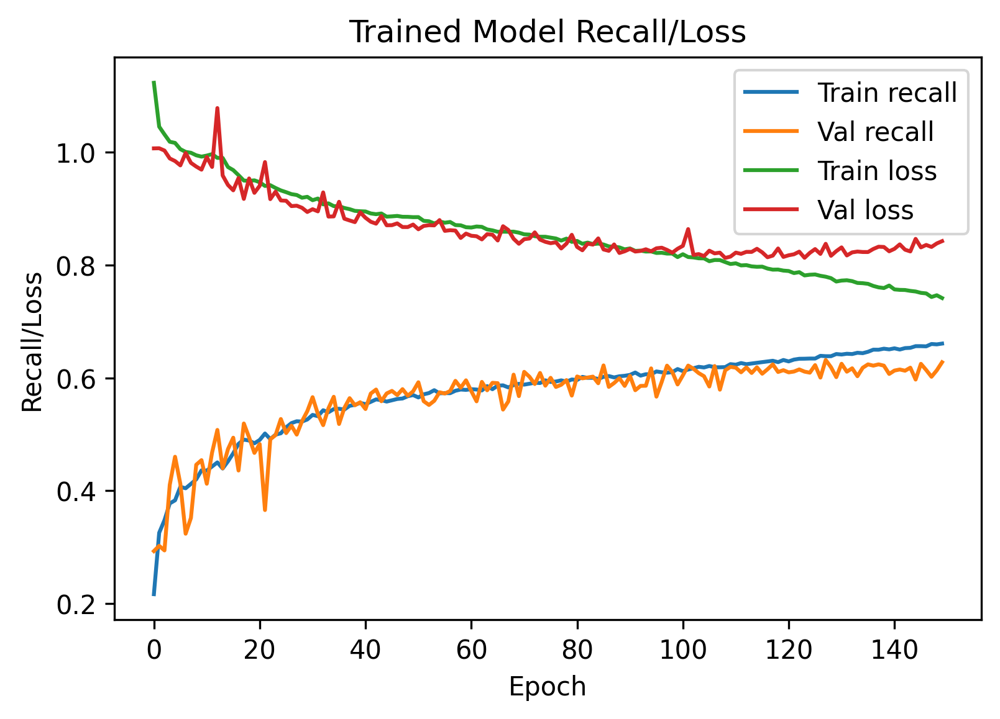

In [ ]:
from matplotlib import pyplot as plt
# Visualization
i = 10 #fold
Train_acc = history[str(i)]["precision"]
Val_acc = history[str(i)]["val_precision"]
Train_loss = history[str(i)]["loss"]
Val_loss = history[str(i)]["val_loss"]
Train_recall = history[str(i)]["recall"]
Val_recall = history[str(i)]["val_recall"]
fig1 = plt.figure(dpi=300)
# plt.plot(Train_acc, label='Train precision')
# plt.plot(Val_acc, label='Val precision')
plt.plot(Train_recall, label='Train recall')
plt.plot(Val_recall, label='Val recall')
plt.plot(Train_loss, label='Train loss')
plt.plot(Val_loss, label='Val loss')
plt.xlabel("Epoch")
plt.ylabel("Recall/Loss")
plt.legend()
plt.title('Trained Model Recall/Loss')
plt.show()

In [ ]:
# create subplots
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(20, 25), dpi=500)
plt.subplots_adjust(hspace=0.4)
for i in range(10):
    Train_acc = history[str(i+1)]["precision"]
    Val_acc = history[str(i+1)]["val_precision"]
    Train_loss = history[str(i+1)]["loss"]
    Val_loss = history[str(i+1)]["val_loss"]
    Train_recall = history[str(i+1)]["recall"]
    Val_recall = history[str(i+1)]["val_recall"]

    axs = plt.subplot(5, 2, i + 1)
    plt.plot(Train_acc, label='Train precision')
    plt.plot(Val_acc, label='Val precision')
    # plt.plot(Train_recall, label='Train recall')
    # plt.plot(Val_recall, label='Val recall')
    plt.plot(Train_loss, label='Train loss')
    plt.plot(Val_loss, label='Val loss')
    text = 'Fold ' + str(i+1) + ': Training'
    axs.set_title(text)
    axs.set_xlabel("Epoch")
    axs.set_ylabel("Precision/Loss")
    plt.legend()

fig.suptitle('Trained Model Precision/Loss', fontsize=18, y=0.92)
plt.show()

In [ ]:
# create subplots
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(20, 25), dpi=500)
plt.subplots_adjust(hspace=0.4)
for i in range(10):
    Train_acc = history[str(i+1)]["f1_score"]
    Val_acc = history[str(i+1)]["val_f1_score"]
    Train_loss = history[str(i+1)]["auc"]
    Val_loss = history[str(i+1)]["val_auc"]
    Train_recall = history[str(i+1)]["recall"]
    Val_recall = history[str(i+1)]["val_recall"]

    axs = plt.subplot(5, 2, i + 1)
    plt.plot(Train_acc, label='Train F1 score')
    plt.plot(Val_acc, label='Val F1 score')
    # plt.plot(Train_recall, label='Train recall')
    # plt.plot(Val_recall, label='Val recall')
    plt.plot(Train_loss, label='Train AUC')
    plt.plot(Val_loss, label='Val AUC')
    text = 'Fold ' + str(i+1) + ': Training'
    axs.set_title(text)
    axs.set_xlabel("Epoch")
    axs.set_ylabel("F1 score/AUC")
    plt.legend()

fig.suptitle('Trained Model F1 score/AUC', fontsize=18, y=0.92)
plt.show()

# Testing Model

In [ ]:
# Loading Model
import tensorflow as tf
models_path = [
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold1_295_0.5305_0.4875.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold2_298_0.5212_0.4811.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold3_268_0.5362_0.4699.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold4_272_0.5431_0.4781.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold5_267_0.5202_0.4707.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold6_266_0.5229_0.4778.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold7_277_0.5449_0.4894.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold8_253_0.5301_0.4666.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold9_291_0.5430_0.4976.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold10_267_0.5312_0.4809.h5'
]

fold=1

model = tf.keras.models.load_model(
    filepath=models_path[fold-1]
    , custom_objects={'focal_loss_fixed': focal_loss()}
)

## Precision, Recall, F1 Score, AUC

In [ ]:
# Evaluating model
import sklearn

print("Evaluate on test data")

print(50*'*')
print('normal')
print(list(enc.inverse_transform(HRV_Y_test)).count(0))

print('obstructive')
print(list(enc.inverse_transform(HRV_Y_test)).count(1))

print('central')
print(list(enc.inverse_transform(HRV_Y_test)).count(2))

print('mix')
print(list(enc.inverse_transform(HRV_Y_test)).count(3))
print(50*'*')

y_pred = model.predict(x={"HRV": HRV_X_test, "EDR": EDR_X_test}, batch_size=2048)
# results = model.evaluate(x={"HRV": HRV_X_test, "EDR": EDR_X_test}, y=HRV_Y_test, batch_size=2048)
# print("test loss, test f1_score, test precision, test recall, test MatthewsCorrelationCoefficient, test auc:")
# print(results)

#Create an instance of One-hot-encoder
enc = sklearn.preprocessing.OneHotEncoder()
enc.fit(np.expand_dims(np.array(All_Y),axis=1))

print('precision recall, f1_score, support')
print(sklearn.metrics.precision_recall_fscore_support(enc.inverse_transform(HRV_Y_test), enc.inverse_transform(y_pred),average=None))
print('AVERAGE MACRO precision recall, f1_score, support')
print(sklearn.metrics.precision_recall_fscore_support(enc.inverse_transform(HRV_Y_test), enc.inverse_transform(y_pred),average='macro'))
print('WEIGHTED  precision recall, f1_score, support')
print(sklearn.metrics.precision_recall_fscore_support(enc.inverse_transform(HRV_Y_test), enc.inverse_transform(y_pred),average='weighted'))
# print('f1_score',sklearn.metrics.f1_score(enc.inverse_transform(HRV_Y_test), enc.inverse_transform(y_pred), average=None))
# print('precision',sklearn.metrics.precision(enc.inverse_transform(HRV_Y_test), enc.inverse_transform(y_pred), average=None))
# print('recall',sklearn.metrics.recall(enc.inverse_transform(HRV_Y_test), enc.inverse_transform(y_pred), average=None))

Evaluate on test data
**************************************************
normal
885
obstructive
953
central
917
mix
220
**************************************************
2/2 [==============================] - 31s 2s/step
precision recall, f1_score, support
(array([0.75809717, 0.664     , 0.80718336, 0.54654655]), array([0.84632768, 0.7838405 , 0.46564885, 0.82727273]), array([0.79978644, 0.71896054, 0.59059474, 0.65822785]), array([885, 953, 917, 220]))
AVERAGE MACRO precision recall, f1_score, support
(0.6939567693444422, 0.7307724423807478, 0.6918923925177238, None)
WEIGHTED MACRO precision recall, f1_score, support
(0.7274404630926824, 0.7075630252100841, 0.6989465206682087, None)


In [ ]:
categories = ['Normal', 'Obstructive','Central','Mix']
print('Fold ',fold)
print('AUC for each class ', categories)
print(sklearn.metrics.roc_auc_score(HRV_Y_test, y_pred, average=None, sample_weight=None, max_fpr=None, multi_class='ovr', labels=categories)) #'ovo'

print('AUC Macro average')
print(sklearn.metrics.roc_auc_score(HRV_Y_test, y_pred, average='macro', sample_weight=None, max_fpr=None, multi_class='ovr', labels=categories)) #'ovo'

print('AUC weighted average')
print(sklearn.metrics.roc_auc_score(HRV_Y_test, y_pred, average='weighted', sample_weight=None, max_fpr=None, multi_class='ovr', labels=categories)) #'ovo'


Fold  1
AUC for each class  ['Normal', 'Obstructive', 'Central', 'Mix']
[0.93559079 0.87496121 0.86252759 0.94408183]
AUC Macro average
0.9042903561425983
AUC weighted average
0.8942761969292274


In [ ]:
# [normal, obstructive, central, mix, Macro, Weighted]
precision = [[0.75809717, 0.664     , 0.80718336, 0.54654655, 0.6939567693444422, 0.7274404630926824],
             [0.72057502, 0.68540434, 0.80181818, 0.58724832,0.6987614664195352,0.7244911374064478],
             [0.69845361, 0.64339623, 0.81545064, 0.62105263,0.6945882775045721,0.7111555853321916],
             [0.72082585, 0.67226061, 0.78044597, 0.61509434,0.6971566933935139,0.7158268744184684],
             [0.72491039, 0.67647059, 0.80727273, 0.59752322,0.7015442323968739,0.725360123960064],
             [0.7154185 , 0.65566038, 0.82591876, 0.62357414,0.7051429465342002,0.7235440439309724],
             [0.73260073, 0.68041237, 0.80797101, 0.60227273,0.7058142113750585,0.7294769943973867],
             [0.71328671, 0.6881473 , 0.76083467, 0.56047198,0.680685164094289,0.7085890225774036],
             [0.74060495, 0.71113561, 0.76558266, 0.65271967,0.7175107206483615,0.7323647866505865],
             [0.77360406, 0.67298578, 0.74767802, 0.59861592,0.6982209446087739,0.7204407693814304]
]
recall = [[0.84632768, 0.7838405 , 0.46564885, 0.82727273,0.7307724423807478,0.7075630252100841],
          [0.90621469, 0.72927597, 0.48091603, 0.79545455,0.7279653089683827,0.7102521008403362],
          [0.91864407, 0.71563484, 0.41439477, 0.80454545,0.7133047813093968,0.6897478991596638],
          [0.90734463, 0.71458552, 0.49618321, 0.74090909,0.7147556122991761,0.7065546218487395],
          [0.91412429, 0.69989507, 0.48418757, 0.87727273,0.7438699143551846,0.7102521008403362],
          [0.91751412, 0.72927597, 0.46564885, 0.74545455,0.7144733738323151,0.7052100840336134],
          [0.9039548 , 0.76180483, 0.48636859, 0.72272727,0.7187138737721304,0.7163025210084034],
          [0.9220339 , 0.62749213, 0.51690294, 0.86363636,0.7325163341101835,0.6984873949579832],
          [0.91299435, 0.67681007, 0.61613959, 0.70909091,0.7287587296077214,0.7307563025210084],
          [0.86101695, 0.74501574, 0.52671756, 0.78636364,0.7297784706343093,0.7152941176470589],
]
f1 = [  [0.79978644, 0.71896054, 0.59059474, 0.65822785,0.6918923925177238,0.6989465206682087],
      [0.8028028 , 0.70665989, 0.60122699, 0.67567568,0.6965913401245147,0.700470976778033],
      [0.79355783, 0.67759563, 0.54953001, 0.7009901 ,0.6804183919362929,0.6743476149837022],
      [0.8034017 , 0.69277721, 0.60666667, 0.67216495,0.6937526321462866,0.6976190960898555],
      [0.8085957 , 0.6879835 , 0.60531697, 0.71086556,0.7031904334765264,0.700074472908078],
      [0.8039604 , 0.69051167, 0.59553696, 0.67908903,0.6922745141566613,0.6941410264745506],
      [0.80930703, 0.71881188, 0.60721579, 0.65702479,0.69808987462197,0.7067653048259053],
      [0.80433711, 0.65642151, 0.61558442, 0.67978533,0.6890320933072974,0.6895636065659554],
      [0.81781377, 0.69354839, 0.68277946, 0.67973856,0.7184700426409543,0.7261741311189567],
      [0.81497326, 0.70717131, 0.61804223, 0.67976424,0.7049877617188942,0.7097406571868732]
]
auc = [[0.93559079, 0.87496121, 0.86252759, 0.94408183,0.9042903561425983,0.8942761969292274],
       [0.93302327, 0.88709635, 0.86323023, 0.94325194,0.906650447012909,0.8975549452558691],
       [0.93322926, 0.86751219, 0.84932752, 0.94653358,0.8991506362290196,0.8873000787642117],
       [0.93290758 ,0.87454293 ,0.84609307, 0.94036298,0.8984766399389545,0.888003302154362],
       [0.93520585 ,0.87670021, 0.85331864, 0.95271737, 0.9044855198877946,0.8925188229026785],
       [0.93878869 ,0.87801523 ,0.86440738, 0.92885992,0.9025178057504795,0.8956595814050529],
       [0.93867624 ,0.88710102 ,0.85416594, 0.92511632,0.9012648773555507,0.8951030231848055],
       [0.93209472 ,0.87360156 ,0.85752226, 0.9500594 ,0.9033194832166314,0.8916998623062552],
       [0.94357554 ,0.88278958 ,0.87860656 ,0.9453143 ,0.9125714957787929,0.9042064482959197],
       [0.93732301 ,0.87324815, 0.85921764, 0.94859264,0.904595360178527,0.8935560696804471]
]

In [ ]:
import numpy as np
np.mean(np.array(auc)[:,5])

0.8939878330878829

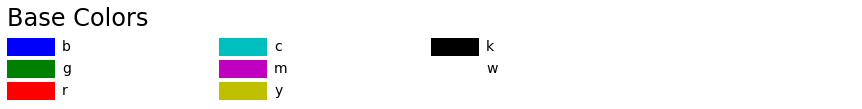

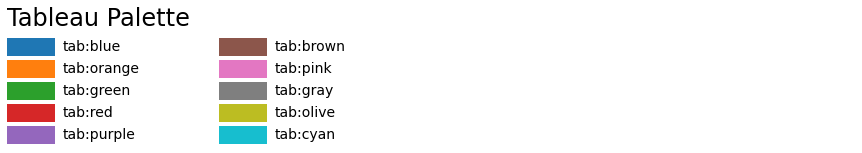

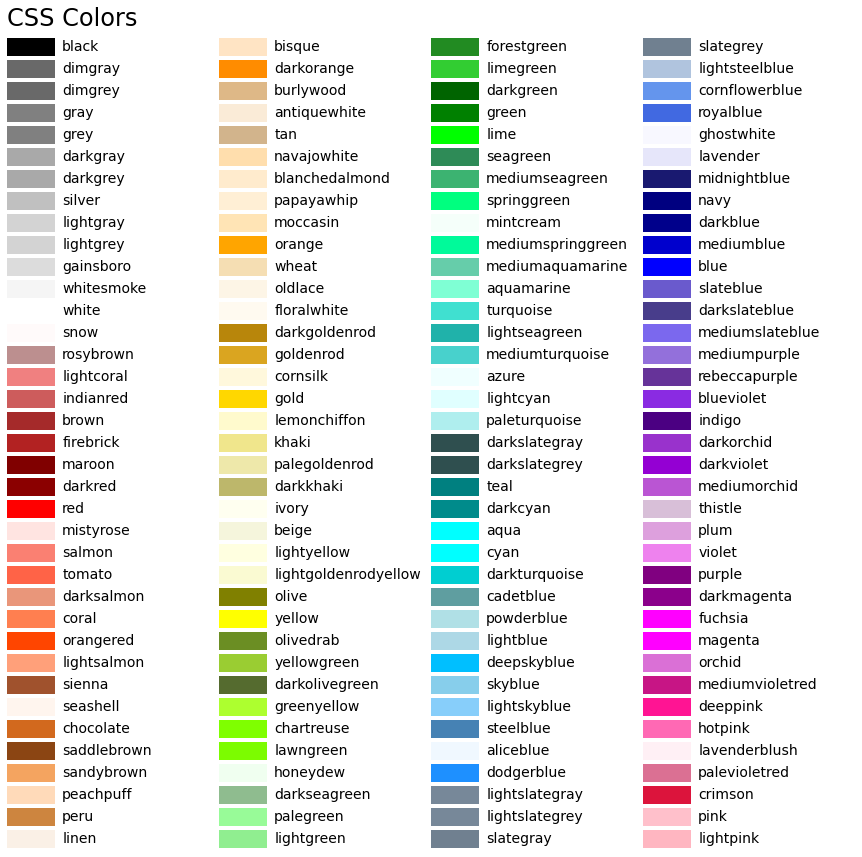

In [ ]:
from matplotlib.patches import Rectangle
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors


def plot_colortable(colors, title, sort_colors=True, emptycols=0):

    cell_width = 212
    cell_height = 22
    swatch_width = 48
    margin = 12
    topmargin = 40

    # Sort colors by hue, saturation, value and name.
    if sort_colors is True:
        by_hsv = sorted((tuple(mcolors.rgb_to_hsv(mcolors.to_rgb(color))),
                         name)
                        for name, color in colors.items())
        names = [name for hsv, name in by_hsv]
    else:
        names = list(colors)

    n = len(names)
    ncols = 4 - emptycols
    nrows = n // ncols + int(n % ncols > 0)

    width = cell_width * 4 + 2 * margin
    height = cell_height * nrows + margin + topmargin
    dpi = 72

    fig, ax = plt.subplots(figsize=(width / dpi, height / dpi), dpi=dpi)
    fig.subplots_adjust(margin/width, margin/height,
                        (width-margin)/width, (height-topmargin)/height)
    ax.set_xlim(0, cell_width * 4)
    ax.set_ylim(cell_height * (nrows-0.5), -cell_height/2.)
    ax.yaxis.set_visible(False)
    ax.xaxis.set_visible(False)
    ax.set_axis_off()
    ax.set_title(title, fontsize=24, loc="left", pad=10)

    for i, name in enumerate(names):
        row = i % nrows
        col = i // nrows
        y = row * cell_height

        swatch_start_x = cell_width * col
        text_pos_x = cell_width * col + swatch_width + 7

        ax.text(text_pos_x, y, name, fontsize=14,
                horizontalalignment='left',
                verticalalignment='center')

        ax.add_patch(
            Rectangle(xy=(swatch_start_x, y-9), width=swatch_width,
                      height=18, facecolor=colors[name])
        )

    return fig

plot_colortable(mcolors.BASE_COLORS, "Base Colors",
                sort_colors=False, emptycols=1)
plot_colortable(mcolors.TABLEAU_COLORS, "Tableau Palette",
                sort_colors=False, emptycols=2)

plot_colortable(mcolors.CSS4_COLORS, "CSS Colors")

# Optionally plot the XKCD colors (Caution: will produce large figure)
#xkcd_fig = plot_colortable(mcolors.XKCD_COLORS, "XKCD Colors")
#xkcd_fig.savefig("XKCD_Colors.png")

plt.show()

In [ ]:
mcolors.CSS4_COLORS

{'aliceblue': '#F0F8FF',
 'antiquewhite': '#FAEBD7',
 'aqua': '#00FFFF',
 'aquamarine': '#7FFFD4',
 'azure': '#F0FFFF',
 'beige': '#F5F5DC',
 'bisque': '#FFE4C4',
 'black': '#000000',
 'blanchedalmond': '#FFEBCD',
 'blue': '#0000FF',
 'blueviolet': '#8A2BE2',
 'brown': '#A52A2A',
 'burlywood': '#DEB887',
 'cadetblue': '#5F9EA0',
 'chartreuse': '#7FFF00',
 'chocolate': '#D2691E',
 'coral': '#FF7F50',
 'cornflowerblue': '#6495ED',
 'cornsilk': '#FFF8DC',
 'crimson': '#DC143C',
 'cyan': '#00FFFF',
 'darkblue': '#00008B',
 'darkcyan': '#008B8B',
 'darkgoldenrod': '#B8860B',
 'darkgray': '#A9A9A9',
 'darkgreen': '#006400',
 'darkgrey': '#A9A9A9',
 'darkkhaki': '#BDB76B',
 'darkmagenta': '#8B008B',
 'darkolivegreen': '#556B2F',
 'darkorange': '#FF8C00',
 'darkorchid': '#9932CC',
 'darkred': '#8B0000',
 'darksalmon': '#E9967A',
 'darkseagreen': '#8FBC8F',
 'darkslateblue': '#483D8B',
 'darkslategray': '#2F4F4F',
 'darkslategrey': '#2F4F4F',
 'darkturquoise': '#00CED1',
 'darkviolet': '#9400D3

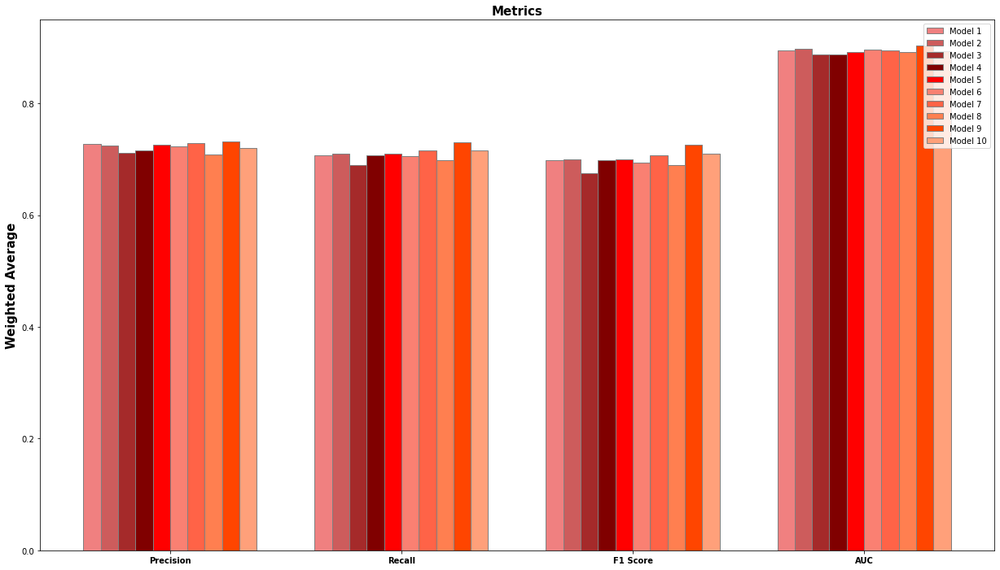

In [ ]:
#### ploting Metrics ####

import numpy as np
import matplotlib.pyplot as plt

# set height of bar
model1_meanplt = [precision[0][-1], recall[0][-1],f1[0][-1],auc[0][-1]]
model2_meanplt = [precision[1][-1], recall[1][-1],f1[1][-1],auc[1][-1]]
model3_meanplt = [precision[2][-1], recall[2][-1],f1[2][-1],auc[2][-1]]
model4_meanplt = [precision[3][-1], recall[3][-1],f1[3][-1],auc[3][-1]]
model5_meanplt = [precision[4][-1], recall[4][-1],f1[4][-1],auc[4][-1]]
model6_meanplt = [precision[5][-1], recall[5][-1],f1[5][-1],auc[5][-1]]
model7_meanplt = [precision[6][-1], recall[6][-1],f1[6][-1],auc[6][-1]]
model8_meanplt = [precision[7][-1], recall[7][-1],f1[7][-1],auc[7][-1]]
model9_meanplt = [precision[8][-1], recall[8][-1],f1[8][-1],auc[8][-1]]
model10_meanplt = [precision[9][-1], recall[9][-1],f1[9][-1],auc[9][-1]]

# model1_stdplt = ( np.std(psnr_rslt1), np.std(ssim_rslt1), np.std(msssim_rslt1), np.std(fsim_rslt1) )
# model2_stdplt = ( np.std(psnr_rslt2), np.std(ssim_rslt2), np.std(msssim_rslt2), np.std(fsim_rslt2) )
# model3_stdplt = ( np.std(psnr_rslt3), np.std(ssim_rslt3), np.std(msssim_rslt3), np.std(fsim_rslt3) )

# psnr_meanplt = (np.mean(psnr_rslt1), np.mean(psnr_rslt2), np.mean(psnr_rslt3))
# ssim_meanplt = (np.mean(ssim_rslt1), np.mean(ssim_rslt2), np.mean(ssim_rslt3))
# msssim_meanplt = (np.mean(msssim_rslt1), np.mean(msssim_rslt2), np.mean(msssim_rslt3))
# fsim_meanplt = (np.mean(fsim_rslt1), np.mean(fsim_rslt2), np.mean(fsim_rslt3))

# psnr_stdplt = (np.std(psnr_rslt1), np.std(psnr_rslt2), np.std(psnr_rslt3))
# ssim_stdplt = (np.std(ssim_rslt1), np.std(ssim_rslt2), np.std(ssim_rslt3))
# msssim_stdplt = (np.std(msssim_rslt1), np.std(msssim_rslt2), np.std(msssim_rslt3))
# fsim_stdplt = (np.std(fsim_rslt1), np.std(fsim_rslt2), np.std(fsim_rslt3))


fig = plt.subplots(figsize =(21, 12))

# set width of bar
barWidth = 0.075

# Set position of bar on X axis
br1 = np.arange(len(model1_meanplt))
br2 = [x + barWidth for x in br1]
br3 = [x + barWidth for x in br2]
br4 = [x + barWidth for x in br3]
br5 = [x + barWidth for x in br4]
br6 = [x + barWidth for x in br5]
br7 = [x + barWidth for x in br6]
br8 = [x + barWidth for x in br7]
br9 = [x + barWidth for x in br8]
br10 = [x + barWidth for x in br9]

# Make the plot
plt.bar(br1, model1_meanplt, color ='lightcoral', width = barWidth, edgecolor ='grey', label ='Model 1')
plt.bar(br2, model2_meanplt, color ='indianred', width = barWidth, edgecolor ='grey', label ='Model 2')
plt.bar(br3, model3_meanplt, color ='brown', width = barWidth, edgecolor ='grey', label ='Model 3')
plt.bar(br4, model4_meanplt, color ='maroon', width = barWidth, edgecolor ='grey', label ='Model 4')
plt.bar(br5, model5_meanplt, color ='red', width = barWidth, edgecolor ='grey', label ='Model 5')
plt.bar(br6, model6_meanplt, color ='salmon', width = barWidth, edgecolor ='grey', label ='Model 6')
plt.bar(br7, model7_meanplt, color ='tomato', width = barWidth, edgecolor ='grey', label ='Model 7')
plt.bar(br8, model8_meanplt, color ='coral', width = barWidth, edgecolor ='grey', label ='Model 8')
plt.bar(br9, model9_meanplt, color ='orangered', width = barWidth, edgecolor ='grey', label ='Model 9')
plt.bar(br10, model10_meanplt, color ='lightsalmon', width = barWidth, edgecolor ='grey', label ='Model 10')

# Adding Xticks
plt.title('Metrics', fontweight ='bold', fontsize = 15)
plt.ylabel('Weighted Average', fontweight ='bold', fontsize = 15)
plt.xticks([r + 4.5*barWidth for r in range(len(model1_meanplt))], ['Precision', 'Recall', 'F1 Score', 'AUC'], fontweight ='bold')

plt.legend(loc='upper right')
plt.show()

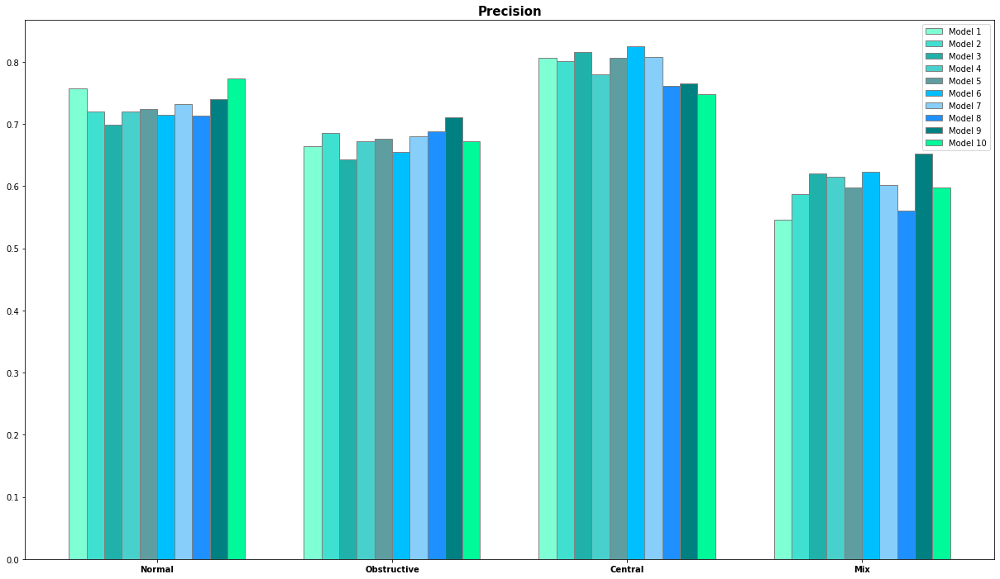

In [ ]:
#### ploting Metrics ####

import numpy as np
import matplotlib.pyplot as plt

# set height of bar
model1_meanplt = precision[0][0:4]
model2_meanplt = precision[1][0:4]
model3_meanplt = precision[2][0:4]
model4_meanplt = precision[3][0:4]
model5_meanplt = precision[4][0:4]
model6_meanplt = precision[5][0:4]
model7_meanplt = precision[6][0:4]
model8_meanplt = precision[7][0:4]
model9_meanplt = precision[8][0:4]
model10_meanplt = precision[9][0:4]

# model1_stdplt = ( np.std(psnr_rslt1), np.std(ssim_rslt1), np.std(msssim_rslt1), np.std(fsim_rslt1) )
# model2_stdplt = ( np.std(psnr_rslt2), np.std(ssim_rslt2), np.std(msssim_rslt2), np.std(fsim_rslt2) )
# model3_stdplt = ( np.std(psnr_rslt3), np.std(ssim_rslt3), np.std(msssim_rslt3), np.std(fsim_rslt3) )

# psnr_meanplt = (np.mean(psnr_rslt1), np.mean(psnr_rslt2), np.mean(psnr_rslt3))
# ssim_meanplt = (np.mean(ssim_rslt1), np.mean(ssim_rslt2), np.mean(ssim_rslt3))
# msssim_meanplt = (np.mean(msssim_rslt1), np.mean(msssim_rslt2), np.mean(msssim_rslt3))
# fsim_meanplt = (np.mean(fsim_rslt1), np.mean(fsim_rslt2), np.mean(fsim_rslt3))

# psnr_stdplt = (np.std(psnr_rslt1), np.std(psnr_rslt2), np.std(psnr_rslt3))
# ssim_stdplt = (np.std(ssim_rslt1), np.std(ssim_rslt2), np.std(ssim_rslt3))
# msssim_stdplt = (np.std(msssim_rslt1), np.std(msssim_rslt2), np.std(msssim_rslt3))
# fsim_stdplt = (np.std(fsim_rslt1), np.std(fsim_rslt2), np.std(fsim_rslt3))


fig = plt.subplots(figsize =(21, 12))

# set width of bar
barWidth = 0.075

# Set position of bar on X axis
br1 = np.arange(len(model1_meanplt))
br2 = [x + barWidth for x in br1]
br3 = [x + barWidth for x in br2]
br4 = [x + barWidth for x in br3]
br5 = [x + barWidth for x in br4]
br6 = [x + barWidth for x in br5]
br7 = [x + barWidth for x in br6]
br8 = [x + barWidth for x in br7]
br9 = [x + barWidth for x in br8]
br10 = [x + barWidth for x in br9]

# Make the plot
plt.bar(br1, model1_meanplt, color ='aquamarine', width = barWidth, edgecolor ='grey', label ='Model 1')
plt.bar(br2, model2_meanplt, color ='turquoise', width = barWidth, edgecolor ='grey', label ='Model 2')
plt.bar(br3, model3_meanplt, color ='lightseagreen', width = barWidth, edgecolor ='grey', label ='Model 3')
plt.bar(br4, model4_meanplt, color ='mediumturquoise', width = barWidth, edgecolor ='grey', label ='Model 4')
plt.bar(br5, model5_meanplt, color ='cadetblue', width = barWidth, edgecolor ='grey', label ='Model 5')
plt.bar(br6, model6_meanplt, color ='deepskyblue', width = barWidth, edgecolor ='grey', label ='Model 6')
plt.bar(br7, model7_meanplt, color ='lightskyblue', width = barWidth, edgecolor ='grey', label ='Model 7')
plt.bar(br8, model8_meanplt, color ='dodgerblue', width = barWidth, edgecolor ='grey', label ='Model 8')
plt.bar(br9, model9_meanplt, color ='teal', width = barWidth, edgecolor ='grey', label ='Model 9')
plt.bar(br10, model10_meanplt, color ='mediumspringgreen', width = barWidth, edgecolor ='grey', label ='Model 10')

# Adding Xticks
plt.title('Precision', fontweight ='bold', fontsize = 15)
# plt.ylabel('Students passed', fontweight ='bold', fontsize = 15)
plt.xticks([r + 4.5*barWidth for r in range(len(model1_meanplt))], ['Normal', 'Obstructive', 'Central', 'Mix'], fontweight ='bold')

plt.legend()
plt.show()

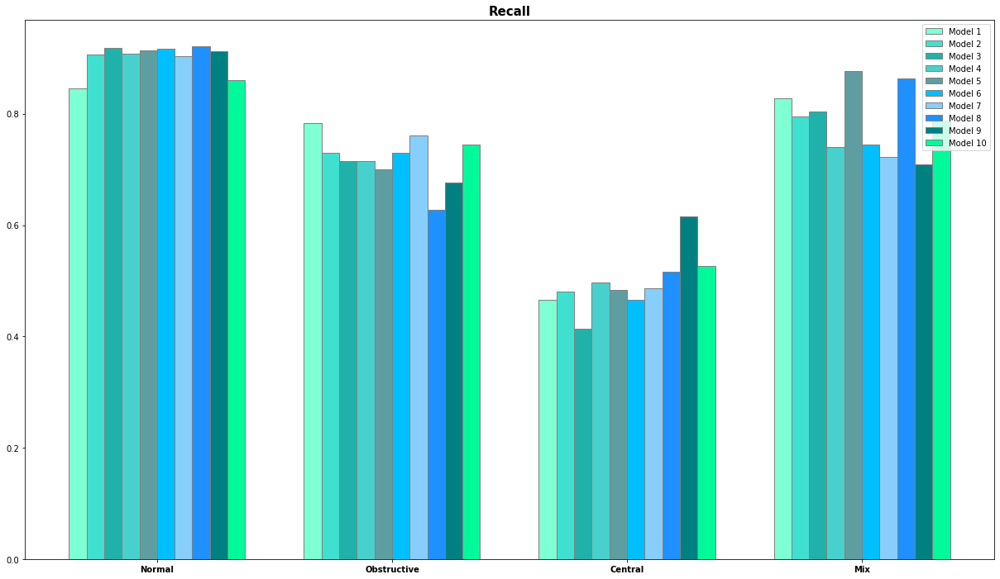

In [ ]:
#### ploting Metrics ####

import numpy as np
import matplotlib.pyplot as plt

# set height of bar
model1_meanplt = recall[0][0:4]
model2_meanplt = recall[1][0:4]
model3_meanplt = recall[2][0:4]
model4_meanplt = recall[3][0:4]
model5_meanplt = recall[4][0:4]
model6_meanplt = recall[5][0:4]
model7_meanplt = recall[6][0:4]
model8_meanplt = recall[7][0:4]
model9_meanplt = recall[8][0:4]
model10_meanplt = recall[9][0:4]

# model1_stdplt = ( np.std(psnr_rslt1), np.std(ssim_rslt1), np.std(msssim_rslt1), np.std(fsim_rslt1) )
# model2_stdplt = ( np.std(psnr_rslt2), np.std(ssim_rslt2), np.std(msssim_rslt2), np.std(fsim_rslt2) )
# model3_stdplt = ( np.std(psnr_rslt3), np.std(ssim_rslt3), np.std(msssim_rslt3), np.std(fsim_rslt3) )

# psnr_meanplt = (np.mean(psnr_rslt1), np.mean(psnr_rslt2), np.mean(psnr_rslt3))
# ssim_meanplt = (np.mean(ssim_rslt1), np.mean(ssim_rslt2), np.mean(ssim_rslt3))
# msssim_meanplt = (np.mean(msssim_rslt1), np.mean(msssim_rslt2), np.mean(msssim_rslt3))
# fsim_meanplt = (np.mean(fsim_rslt1), np.mean(fsim_rslt2), np.mean(fsim_rslt3))

# psnr_stdplt = (np.std(psnr_rslt1), np.std(psnr_rslt2), np.std(psnr_rslt3))
# ssim_stdplt = (np.std(ssim_rslt1), np.std(ssim_rslt2), np.std(ssim_rslt3))
# msssim_stdplt = (np.std(msssim_rslt1), np.std(msssim_rslt2), np.std(msssim_rslt3))
# fsim_stdplt = (np.std(fsim_rslt1), np.std(fsim_rslt2), np.std(fsim_rslt3))


fig = plt.subplots(figsize =(21, 12))

# set width of bar
barWidth = 0.075

# Set position of bar on X axis
br1 = np.arange(len(model1_meanplt))
br2 = [x + barWidth for x in br1]
br3 = [x + barWidth for x in br2]
br4 = [x + barWidth for x in br3]
br5 = [x + barWidth for x in br4]
br6 = [x + barWidth for x in br5]
br7 = [x + barWidth for x in br6]
br8 = [x + barWidth for x in br7]
br9 = [x + barWidth for x in br8]
br10 = [x + barWidth for x in br9]

# Make the plot
plt.bar(br1, model1_meanplt, color ='aquamarine', width = barWidth, edgecolor ='grey', label ='Model 1')
plt.bar(br2, model2_meanplt, color ='turquoise', width = barWidth, edgecolor ='grey', label ='Model 2')
plt.bar(br3, model3_meanplt, color ='lightseagreen', width = barWidth, edgecolor ='grey', label ='Model 3')
plt.bar(br4, model4_meanplt, color ='mediumturquoise', width = barWidth, edgecolor ='grey', label ='Model 4')
plt.bar(br5, model5_meanplt, color ='cadetblue', width = barWidth, edgecolor ='grey', label ='Model 5')
plt.bar(br6, model6_meanplt, color ='deepskyblue', width = barWidth, edgecolor ='grey', label ='Model 6')
plt.bar(br7, model7_meanplt, color ='lightskyblue', width = barWidth, edgecolor ='grey', label ='Model 7')
plt.bar(br8, model8_meanplt, color ='dodgerblue', width = barWidth, edgecolor ='grey', label ='Model 8')
plt.bar(br9, model9_meanplt, color ='teal', width = barWidth, edgecolor ='grey', label ='Model 9')
plt.bar(br10, model10_meanplt, color ='mediumspringgreen', width = barWidth, edgecolor ='grey', label ='Model 10')

# Adding Xticks
plt.title('Recall', fontweight ='bold', fontsize = 15)
# plt.ylabel('Students passed', fontweight ='bold', fontsize = 15)
plt.xticks([r + 4.5*barWidth for r in range(len(model1_meanplt))], ['Normal', 'Obstructive', 'Central', 'Mix'], fontweight ='bold')

plt.legend()
plt.show()

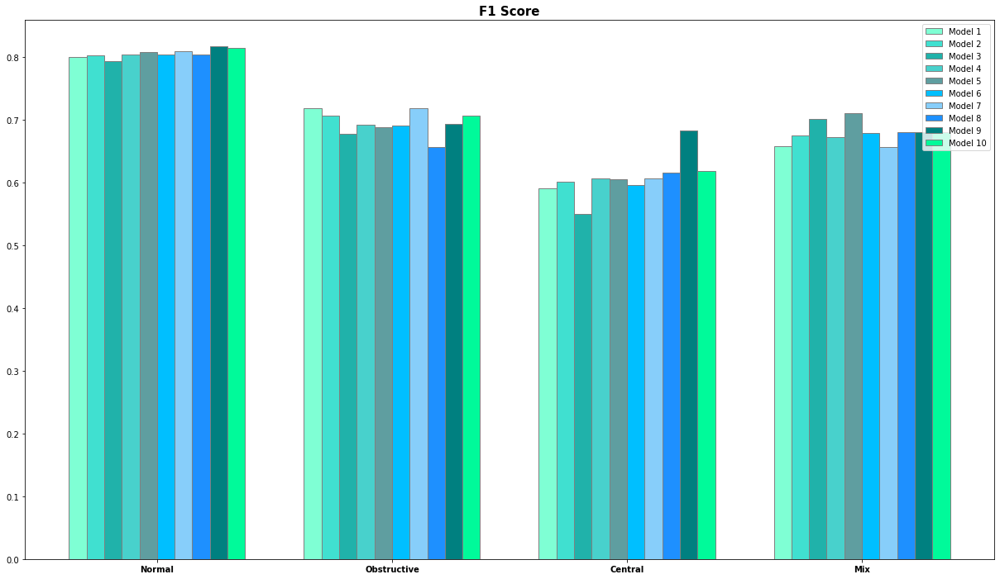

In [ ]:
#### ploting Metrics ####

import numpy as np
import matplotlib.pyplot as plt

# set height of bar
model1_meanplt = f1[0][0:4]
model2_meanplt = f1[1][0:4]
model3_meanplt = f1[2][0:4]
model4_meanplt = f1[3][0:4]
model5_meanplt = f1[4][0:4]
model6_meanplt = f1[5][0:4]
model7_meanplt = f1[6][0:4]
model8_meanplt = f1[7][0:4]
model9_meanplt = f1[8][0:4]
model10_meanplt = f1[9][0:4]

# model1_stdplt = ( np.std(psnr_rslt1), np.std(ssim_rslt1), np.std(msssim_rslt1), np.std(fsim_rslt1) )
# model2_stdplt = ( np.std(psnr_rslt2), np.std(ssim_rslt2), np.std(msssim_rslt2), np.std(fsim_rslt2) )
# model3_stdplt = ( np.std(psnr_rslt3), np.std(ssim_rslt3), np.std(msssim_rslt3), np.std(fsim_rslt3) )

# psnr_meanplt = (np.mean(psnr_rslt1), np.mean(psnr_rslt2), np.mean(psnr_rslt3))
# ssim_meanplt = (np.mean(ssim_rslt1), np.mean(ssim_rslt2), np.mean(ssim_rslt3))
# msssim_meanplt = (np.mean(msssim_rslt1), np.mean(msssim_rslt2), np.mean(msssim_rslt3))
# fsim_meanplt = (np.mean(fsim_rslt1), np.mean(fsim_rslt2), np.mean(fsim_rslt3))

# psnr_stdplt = (np.std(psnr_rslt1), np.std(psnr_rslt2), np.std(psnr_rslt3))
# ssim_stdplt = (np.std(ssim_rslt1), np.std(ssim_rslt2), np.std(ssim_rslt3))
# msssim_stdplt = (np.std(msssim_rslt1), np.std(msssim_rslt2), np.std(msssim_rslt3))
# fsim_stdplt = (np.std(fsim_rslt1), np.std(fsim_rslt2), np.std(fsim_rslt3))


fig = plt.subplots(figsize =(21, 12))

# set width of bar
barWidth = 0.075

# Set position of bar on X axis
br1 = np.arange(len(model1_meanplt))
br2 = [x + barWidth for x in br1]
br3 = [x + barWidth for x in br2]
br4 = [x + barWidth for x in br3]
br5 = [x + barWidth for x in br4]
br6 = [x + barWidth for x in br5]
br7 = [x + barWidth for x in br6]
br8 = [x + barWidth for x in br7]
br9 = [x + barWidth for x in br8]
br10 = [x + barWidth for x in br9]

# Make the plot
plt.bar(br1, model1_meanplt, color ='aquamarine', width = barWidth, edgecolor ='grey', label ='Model 1')
plt.bar(br2, model2_meanplt, color ='turquoise', width = barWidth, edgecolor ='grey', label ='Model 2')
plt.bar(br3, model3_meanplt, color ='lightseagreen', width = barWidth, edgecolor ='grey', label ='Model 3')
plt.bar(br4, model4_meanplt, color ='mediumturquoise', width = barWidth, edgecolor ='grey', label ='Model 4')
plt.bar(br5, model5_meanplt, color ='cadetblue', width = barWidth, edgecolor ='grey', label ='Model 5')
plt.bar(br6, model6_meanplt, color ='deepskyblue', width = barWidth, edgecolor ='grey', label ='Model 6')
plt.bar(br7, model7_meanplt, color ='lightskyblue', width = barWidth, edgecolor ='grey', label ='Model 7')
plt.bar(br8, model8_meanplt, color ='dodgerblue', width = barWidth, edgecolor ='grey', label ='Model 8')
plt.bar(br9, model9_meanplt, color ='teal', width = barWidth, edgecolor ='grey', label ='Model 9')
plt.bar(br10, model10_meanplt, color ='mediumspringgreen', width = barWidth, edgecolor ='grey', label ='Model 10')

# Adding Xticks
plt.title('F1 Score', fontweight ='bold', fontsize = 15)
# plt.ylabel('Students passed', fontweight ='bold', fontsize = 15)
plt.xticks([r + 4.5*barWidth for r in range(len(model1_meanplt))], ['Normal', 'Obstructive', 'Central', 'Mix'], fontweight ='bold')

plt.legend(loc='upper right')
plt.show()

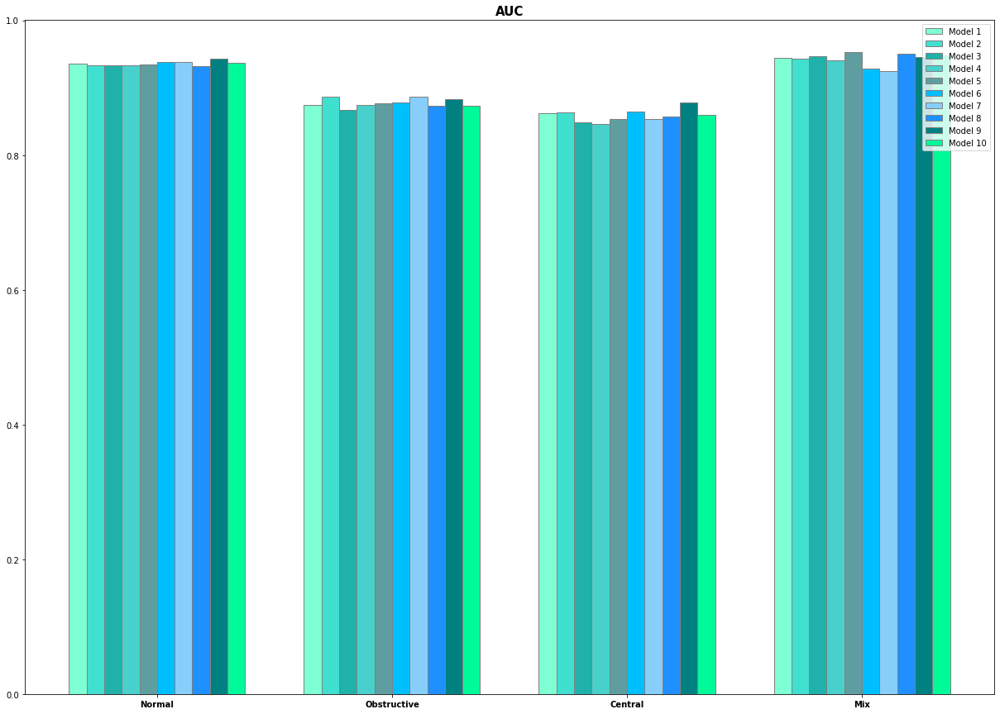

In [ ]:
#### ploting Metrics ####

import numpy as np
import matplotlib.pyplot as plt

# set height of bar
model1_meanplt = auc[0][0:4]
model2_meanplt = auc[1][0:4]
model3_meanplt = auc[2][0:4]
model4_meanplt = auc[3][0:4]
model5_meanplt = auc[4][0:4]
model6_meanplt = auc[5][0:4]
model7_meanplt = auc[6][0:4]
model8_meanplt = auc[7][0:4]
model9_meanplt = auc[8][0:4]
model10_meanplt = auc[9][0:4]

# model1_stdplt = ( np.std(psnr_rslt1), np.std(ssim_rslt1), np.std(msssim_rslt1), np.std(fsim_rslt1) )
# model2_stdplt = ( np.std(psnr_rslt2), np.std(ssim_rslt2), np.std(msssim_rslt2), np.std(fsim_rslt2) )
# model3_stdplt = ( np.std(psnr_rslt3), np.std(ssim_rslt3), np.std(msssim_rslt3), np.std(fsim_rslt3) )

# psnr_meanplt = (np.mean(psnr_rslt1), np.mean(psnr_rslt2), np.mean(psnr_rslt3))
# ssim_meanplt = (np.mean(ssim_rslt1), np.mean(ssim_rslt2), np.mean(ssim_rslt3))
# msssim_meanplt = (np.mean(msssim_rslt1), np.mean(msssim_rslt2), np.mean(msssim_rslt3))
# fsim_meanplt = (np.mean(fsim_rslt1), np.mean(fsim_rslt2), np.mean(fsim_rslt3))

# psnr_stdplt = (np.std(psnr_rslt1), np.std(psnr_rslt2), np.std(psnr_rslt3))
# ssim_stdplt = (np.std(ssim_rslt1), np.std(ssim_rslt2), np.std(ssim_rslt3))
# msssim_stdplt = (np.std(msssim_rslt1), np.std(msssim_rslt2), np.std(msssim_rslt3))
# fsim_stdplt = (np.std(fsim_rslt1), np.std(fsim_rslt2), np.std(fsim_rslt3))


fig = plt.subplots(figsize =(21, 15))

# set width of bar
barWidth = 0.075

# Set position of bar on X axis
br1 = np.arange(len(model1_meanplt))
br2 = [x + barWidth for x in br1]
br3 = [x + barWidth for x in br2]
br4 = [x + barWidth for x in br3]
br5 = [x + barWidth for x in br4]
br6 = [x + barWidth for x in br5]
br7 = [x + barWidth for x in br6]
br8 = [x + barWidth for x in br7]
br9 = [x + barWidth for x in br8]
br10 = [x + barWidth for x in br9]

# Make the plot
plt.bar(br1, model1_meanplt, color ='aquamarine', width = barWidth, edgecolor ='grey', label ='Model 1')
plt.bar(br2, model2_meanplt, color ='turquoise', width = barWidth, edgecolor ='grey', label ='Model 2')
plt.bar(br3, model3_meanplt, color ='lightseagreen', width = barWidth, edgecolor ='grey', label ='Model 3')
plt.bar(br4, model4_meanplt, color ='mediumturquoise', width = barWidth, edgecolor ='grey', label ='Model 4')
plt.bar(br5, model5_meanplt, color ='cadetblue', width = barWidth, edgecolor ='grey', label ='Model 5')
plt.bar(br6, model6_meanplt, color ='deepskyblue', width = barWidth, edgecolor ='grey', label ='Model 6')
plt.bar(br7, model7_meanplt, color ='lightskyblue', width = barWidth, edgecolor ='grey', label ='Model 7')
plt.bar(br8, model8_meanplt, color ='dodgerblue', width = barWidth, edgecolor ='grey', label ='Model 8')
plt.bar(br9, model9_meanplt, color ='teal', width = barWidth, edgecolor ='grey', label ='Model 9')
plt.bar(br10, model10_meanplt, color ='mediumspringgreen', width = barWidth, edgecolor ='grey', label ='Model 10')

# Adding Xticks
plt.title('AUC', fontweight ='bold', fontsize = 15)
# plt.ylabel('Students passed', fontweight ='bold', fontsize = 15)
plt.xticks([r + 4.5*barWidth for r in range(len(model1_meanplt))], ['Normal', 'Obstructive', 'Central', 'Mix'], fontweight ='bold')

plt.legend(loc='upper right')
plt.show()

## Confusion Matrix

In [ ]:
def make_confusion_matrix(cf,
                          group_names=None,
                          categories='auto',
                          count=True,
                          percent=True,
                          cbar=True,
                          xyticks=True,
                          xyplotlabels=True,
                          sum_stats=True,
                          figsize=None,
                          cmap='Blues',
                          title=None):
    '''
    This function will make a pretty plot of an sklearn Confusion Matrix cm using a Seaborn heatmap visualization.
    Arguments
    ---------
    cf:            confusion matrix to be passed in
    group_names:   List of strings that represent the labels row by row to be shown in each square.
    categories:    List of strings containing the categories to be displayed on the x,y axis. Default is 'auto'
    count:         If True, show the raw number in the confusion matrix. Default is True.
    normalize:     If True, show the proportions for each category. Default is True.
    cbar:          If True, show the color bar. The cbar values are based off the values in the confusion matrix.
                   Default is True.
    xyticks:       If True, show x and y ticks. Default is True.
    xyplotlabels:  If True, show 'True Label' and 'Predicted Label' on the figure. Default is True.
    sum_stats:     If True, display summary statistics below the figure. Default is True.
    figsize:       Tuple representing the figure size. Default will be the matplotlib rcParams value.
    cmap:          Colormap of the values displayed from matplotlib.pyplot.cm. Default is 'Blues'
                   See http://matplotlib.org/examples/color/colormaps_reference.html

    title:         Title for the heatmap. Default is None.
    '''

    import numpy as np
    import matplotlib.pyplot as plt
    import seaborn as sns

    cf_matrix=cf
    # CODE TO GENERATE TEXT INSIDE EACH SQUARE
    blanks = ['' for i in range(cf.size)]

    if group_names and len(group_names)==cf.size:
        group_labels = ["{}\n".format(value) for value in group_names]
    else:
        group_labels = blanks

    if count:
        group_counts = ["{0:0.0f}\n".format(value) for value in cf.flatten()]
    else:
        group_counts = blanks

    if percent:
        group_percentages = []
        group_percentages_str = []
        for i in range(len(cf_matrix)):
            for j in range(len(cf_matrix[i])):
                group_percentages_str.append("{0:.2%}\n".format(cf_matrix[i][j]/np.sum(cf_matrix[i])))
                group_percentages.append(cf_matrix[i][j]/np.sum(cf_matrix[i]))
    else:
        group_percentages = blanks

    # box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_labels,group_counts,group_percentages)]
    box_labels = [f"{v1}{v2}{v3}".strip() for v1, v2, v3 in zip(group_percentages_str,group_labels,cf.flatten())]
    box_labels = np.asarray(box_labels).reshape(cf.shape[0],cf.shape[1])


    # CODE TO GENERATE SUMMARY STATISTICS & TEXT FOR SUMMARY STATS
    if sum_stats:
        #Accuracy is sum of diagonal divided by total observations
        accuracy  = np.trace(cf) / float(np.sum(cf))

        #if it is a binary confusion matrix, show some more stats
        if len(cf)==2:
            #Metrics for Binary Confusion Matrices
            precision = cf[1,1] / sum(cf[:,1])
            recall    = cf[1,1] / sum(cf[1,:])
            f1_score  = 2*precision*recall / (precision + recall)
            stats_text = "\n\nAccuracy={:0.3f}\nPrecision={:0.3f}\nRecall={:0.3f}\nF1 Score={:0.3f}".format(
                accuracy,precision,recall,f1_score)
        else:
            stats_text = "\n\nAccuracy={:0.3f}".format(accuracy)
    else:
        stats_text = ""


    # SET FIGURE PARAMETERS ACCORDING TO OTHER ARGUMENTS
    if figsize==None:
        #Get default figure size if not set
        figsize = plt.rcParams.get('figure.figsize')

    if xyticks==False:
        #Do not show categories if xyticks is False
        categories=False


    # MAKE THE HEATMAP VISUALIZATION
    # plt.figure(figsize=figsize)
    # sns.heatmap(cf,annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)
    sns.heatmap(np.asarray(group_percentages).reshape(cf.shape[0],cf.shape[1]),annot=box_labels,fmt="",cmap=cmap,cbar=cbar,xticklabels=categories,yticklabels=categories)

    if xyplotlabels:
        plt.ylabel('True label')
        plt.xlabel('Predicted label' + stats_text)
    else:
        plt.xlabel(stats_text)

    if title:
        plt.title(title)

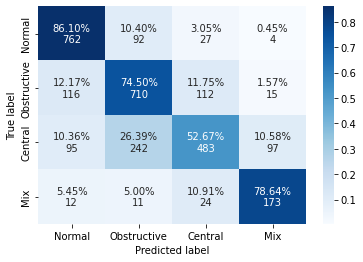

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

#Get the confusion matrix
cf_matrix = confusion_matrix(enc.inverse_transform(HRV_Y_test), enc.inverse_transform(y_pred))
categories = ['Normal', 'Obstructive','Central','Mix']

make_confusion_matrix(cf_matrix,
                      categories=categories,
                      percent=True,
                      sum_stats=False,
                      cmap='Blues',
                      figsize=[10,5]
                      )

# sns.heatmap(cf_matrix, categories=categories, annot=True)

In [ ]:
cf_matrix

array([[762,  92,  27,   4],
       [116, 710, 112,  15],
       [ 95, 242, 483,  97],
       [ 12,  11,  24, 173]])

In [ ]:
# Loading Model
import tensorflow as tf
models_path = [
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold1_295_0.5305_0.4875.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold2_298_0.5212_0.4811.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold3_268_0.5362_0.4699.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold4_272_0.5431_0.4781.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold5_267_0.5202_0.4707.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold6_266_0.5229_0.4778.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold7_277_0.5449_0.4894.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold8_253_0.5301_0.4666.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold9_291_0.5430_0.4976.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold10_267_0.5312_0.4809.h5'
]

# create subplots
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(20, 25), dpi=500)
plt.subplots_adjust(hspace=0.4)
plt.subplots_adjust(wspace=0.05)

for i in range(len(models_path)):

    model = tf.keras.models.load_model(
        filepath=models_path[i]
        , custom_objects={'focal_loss_fixed': focal_loss()}
    )

    y_pred = model.predict(x={"HRV": HRV_X_test, "EDR": EDR_X_test}, batch_size=2048)

    #Create an instance of One-hot-encoder
    enc = sklearn.preprocessing.OneHotEncoder()
    enc.fit(np.expand_dims(np.array(All_Y),axis=1))


    #Get the confusion matrix
    cf_matrix = confusion_matrix(enc.inverse_transform(HRV_Y_test), enc.inverse_transform(y_pred))
    categories = ['Normal', 'Obstructive','Central','Mix']

    axs = plt.subplot(5, 2, i + 1)

    make_confusion_matrix(cf_matrix,
                          categories=categories,
                          percent=True,
                          sum_stats=False,
                          cmap='Blues',
                          figsize=[10,5]
                          )

    text = 'Fold ' + str(i+1)
    axs.set_title(text)

fig.suptitle('Confusion Matrix', fontsize=18, y=0.92)
plt.show()

2/2 [==============================] - 1s 144ms/step


## ROC

In [ ]:
from sklearn.metrics import roc_auc_score

micro_roc_auc_ovr = roc_auc_score(
    HRV_Y_test,
    y_pred,
    multi_class="ovr",
    average="micro",
)

print(f"Micro-averaged One-vs-Rest ROC AUC score:\n{micro_roc_auc_ovr:.2f}")

from sklearn.metrics import roc_curve, auc

# store the fpr, tpr, and roc_auc for all averaging strategies
fpr, tpr, roc_auc = dict(), dict(), dict()
# Compute micro-average ROC curve and ROC area
fpr["micro"], tpr["micro"], _ = roc_curve(HRV_Y_test.ravel(), y_pred.ravel())
roc_auc["micro"] = auc(fpr["micro"], tpr["micro"])

print(f"Micro-averaged One-vs-Rest ROC AUC score:\n{roc_auc['micro']:.2f}")

In [ ]:
n_classes = 4
for i in range(n_classes):
    fpr[i], tpr[i], _ = roc_curve(HRV_Y_test[:, i], y_pred[:, i])
    roc_auc[i] = auc(fpr[i], tpr[i])

fpr_grid = np.linspace(0.0, 1.0, 1000)

# Interpolate all ROC curves at these points
mean_tpr = np.zeros_like(fpr_grid)

for i in range(n_classes):
    mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

# Average it and compute AUC
mean_tpr /= n_classes

fpr["macro"] = fpr_grid
tpr["macro"] = mean_tpr
roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])

print(f"Macro-averaged One-vs-Rest ROC AUC score:\n{roc_auc['macro']:.2f}")

In [ ]:
from itertools import cycle
from sklearn.metrics import RocCurveDisplay

target_names = ['Normal', 'Obstructive','Central','Mix']
fig, ax = plt.subplots(figsize=(10, 10))

# plt.plot(
#     fpr["weighted"],
#     tpr["weighted"],
#     label=f"weighted-average ROC curve (AUC = {roc_auc['weighted']:.2f})",
#     color="deeppink",
#     linestyle=":",
#     linewidth=4,
# )

plt.plot(
    fpr["macro"],
    tpr["macro"],
    label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
    color="navy",
    linestyle=":",
    linewidth=4,
)

colors = cycle(["aqua", "darkorange", "cornflowerblue","red"])
for class_id, color in zip(range(n_classes), colors):
    RocCurveDisplay.from_predictions(
        HRV_Y_test[:, class_id],
        y_pred[:, class_id],
        name=f"ROC curve for {target_names[class_id]}",
        color=color,
        ax=ax,
    )

plt.plot([0, 1], [0, 1], "k--", label="ROC curve for chance level (AUC = 0.5)")
plt.axis("square")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.title("Extension of Receiver Operating Characteristic\nto One-vs-Rest multiclass")
plt.legend()
plt.show()

2/2 [==============================] - 1s 98ms/step


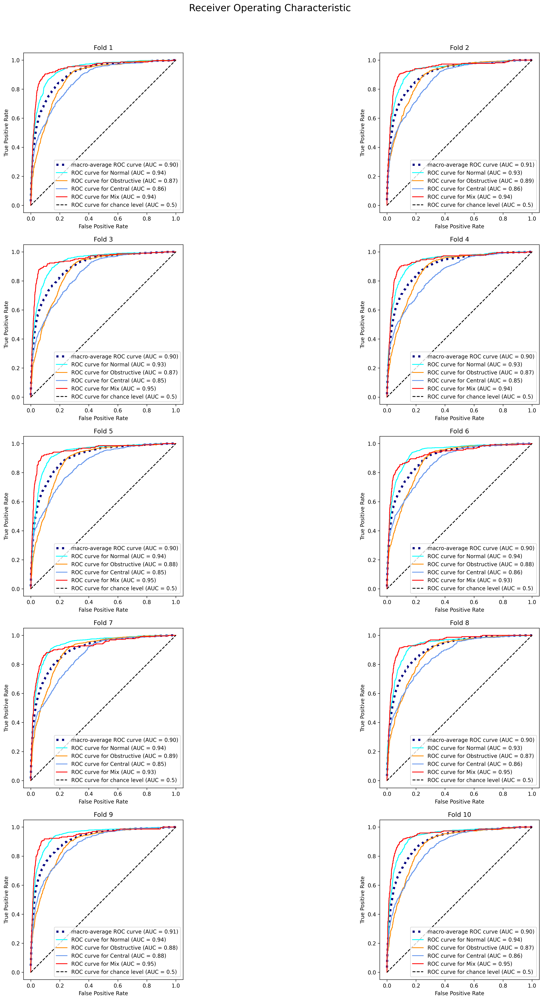

In [ ]:
# Loading Model
import tensorflow as tf
import sklearn
from itertools import cycle
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import RocCurveDisplay

models_path = [
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold1_295_0.5305_0.4875.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold2_298_0.5212_0.4811.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold3_268_0.5362_0.4699.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold4_272_0.5431_0.4781.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold5_267_0.5202_0.4707.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold6_266_0.5229_0.4778.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold7_277_0.5449_0.4894.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold8_253_0.5301_0.4666.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold9_291_0.5430_0.4976.h5',
    '/content/drive/MyDrive/Work/Mina/saved_models/model_fold10_267_0.5312_0.4809.h5'
]

# create subplots
fig, axs = plt.subplots(nrows=5, ncols=2, figsize=(24, 32), dpi=300)
plt.subplots_adjust(hspace=0.2)
plt.subplots_adjust(wspace=0)

for i in range(len(models_path)):

    model = tf.keras.models.load_model(
        filepath=models_path[i]
        , custom_objects={'focal_loss_fixed': focal_loss()}
    )

    y_pred = model.predict(x={"HRV": HRV_X_test, "EDR": EDR_X_test}, batch_size=2048)

    #Create an instance of One-hot-encoder
    enc = sklearn.preprocessing.OneHotEncoder()
    enc.fit(np.expand_dims(np.array(All_Y),axis=1))


    #Get the confusion matrix
    categories = ['Normal', 'Obstructive','Central','Mix']

    axs = plt.subplot(5, 2, i + 1)
    text = 'Fold ' + str(i+1)
    axs.set_title(text)
    # fig.set_figheight(10)
    # fig.set_figwidth(15)
    # store the fpr, tpr, and roc_auc for all averaging strategies
    fpr, tpr, roc_auc = dict(), dict(), dict()
    # macro
    n_classes = 4
    for i in range(n_classes):
        fpr[i], tpr[i], _ = roc_curve(HRV_Y_test[:, i], y_pred[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    fpr_grid = np.linspace(0.0, 1.0, 1000)

    # Interpolate all ROC curves at these points
    mean_tpr = np.zeros_like(fpr_grid)

    for i in range(n_classes):
        mean_tpr += np.interp(fpr_grid, fpr[i], tpr[i])  # linear interpolation

    # Average it and compute AUC
    mean_tpr /= n_classes

    fpr["macro"] = fpr_grid
    tpr["macro"] = mean_tpr
    roc_auc["macro"] = auc(fpr["macro"], tpr["macro"])



    target_names = ['Normal', 'Obstructive','Central','Mix']

    axs.plot(
        fpr["macro"],
        tpr["macro"],
        label=f"macro-average ROC curve (AUC = {roc_auc['macro']:.2f})",
        color="navy",
        linestyle=":",
        linewidth=4,
    )

    colors = cycle(["aqua", "darkorange", "cornflowerblue","red"])
    for class_id, color in zip(range(n_classes), colors):
        RocCurveDisplay.from_predictions(
            HRV_Y_test[:, class_id],
            y_pred[:, class_id],
            name=f"ROC curve for {target_names[class_id]}",
            color=color,
            ax=axs,
        )

    axs.plot([0, 1], [0, 1], "k--", label="ROC curve for chance level (AUC = 0.5)")
    axs.axis("square")

    axs.set_xlabel("False Positive Rate")
    axs.set_ylabel("True Positive Rate")
    axs.legend(prop={'size': 10})


fig.suptitle('Receiver Operating Characteristic', fontsize=18, y=0.92)
plt.show()